In [1]:
                   #Initial Definitions, uploading the data, and cleaning up the data
    
import tensorflow as tf
import numpy as np
import time
from IPython.display import display, HTML
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pickle


                                            #Upload data
    
#init_notebook_mode(connected=True)
data_path='CRSP_1982-2012.csv'
data_path1='Compustat_1982-2012.csv'
data_CRSP=pd.read_csv(data_path)
data_Compustat=pd.read_csv(data_path1)

                    #Renaming to making data in these colums accessible to df.column_name
    
data_CRSP = data_CRSP.rename(columns={'Names Date': 'Date', 'CUSIP Header': 'CUSIP', 'Ticker Symbol':'Ticker','Price or Bid/Ask Average': 'Price'})
data_Compustat = data_Compustat.rename(columns={'Data Date':'Date','Ticker Symbol':'Ticker'})
data_CRSP=data_CRSP.rename(columns={'Global Company Key':'GCK','Price or Bid/Ask Average':'Price'})


                           #Merge compustat and crsp data into single dataframe
    
data_CRSP.CUSIP=pd.to_numeric(data_CRSP.CUSIP, errors='ignore')
data_Compustat.CUSIP=pd.to_numeric(data_Compustat.CUSIP, errors='ignore')
data_Compustat['CUSIP'] = data_Compustat['CUSIP'].str[:-1]
data_CRSP.Date=pd.to_numeric(data_CRSP.Date, errors='ignore')
data_Compustat.Date=pd.to_numeric(data_Compustat.Date, errors='ignore')
data_CRSP['Date'] = data_CRSP['Date'].astype(str).str[:-2]
data_Compustat['Date'] = data_Compustat['Date'].astype(str).str[:-2]
df = pd.merge(data_Compustat, data_CRSP, on=['Date','CUSIP'], how='inner')
df=df.rename(columns={'Global Company Key':'GCK','Price or Bid/Ask Average':'Price'})
len(df.GCK.unique())
df=df.rename(columns={'Standard Industrial Classification Code':'SICC'})

                                #These are the features of interest chosen 
features = [
 'Current Assets - Other - Total',
 'Assets - Other - Total',
 'Account Payable/Creditors - Trade',
 'Assets - Total',
 'Common/Ordinary Equity - Total',
 'Cash and Short-Term Investments',
 'Long-Term Debt - Total',
 'Discontinued Operations',
 'Dividends - Preferred/Preference',
 'Income Before Extraordinary Items - Adjusted for Common Stock Equivalents',
 'Income Before Extraordinary Items - Available for Common',
 'Income Before Extraordinary Items',
 'Invested Capital - Total - Quarterly',
 'Current Liabilities - Other - Total',
 'Liabilities - Other',
 'Liabilities - Total',
 'Net Income (Loss)',
 'Non-Operating Income (Expense) - Total',
 'Pretax Income',
 'Property Plant and Equipment - Total (Net)',
 'Preferred/Preference Stock (Capital) - Total',
 'Preferred/Preference Stock - Redeemable',
 'Sales/Turnover (Net)',
 'Stockholders Equity > Parent > Index Fundamental > Quarterly',
 'Stockholders Equity - Total',
 'Income Taxes - Total',
 'Extraordinary Items and Discontinued Operations',
 'Cash Dividends',
]

IncomeCashFlowFeatures = [
 'Dividends - Preferred/Preference',
 'Cash and Short-Term Investments',
 'Sales/Turnover (Net)',
 'Net Income (Loss)',
 'Income Before Extraordinary Items - Adjusted for Common Stock Equivalents',
 'Income Before Extraordinary Items - Available for Common',
 'Income Before Extraordinary Items',
 'Pretax Income',
 'Cash Dividends',
 'Income Taxes - Total',
 'Extraordinary Items and Discontinued Operations',
 'Non-Operating Income (Expense) - Total',
]

OtherFeatures = [
 'Current Assets - Other - Total',
 'Assets - Other - Total',
 'Account Payable/Creditors - Trade',
 'Assets - Total',
 'Common/Ordinary Equity - Total',
 'Long-Term Debt - Total',
 'Discontinued Operations',
 'Invested Capital - Total - Quarterly',
 'Current Liabilities - Other - Total',
 'Liabilities - Other',
 'Liabilities - Total',
 'Property Plant and Equipment - Total (Net)',
 'Preferred/Preference Stock (Capital) - Total',
 'Preferred/Preference Stock - Redeemable',
 'Stockholders Equity > Parent > Index Fundamental > Quarterly',
 'Stockholders Equity - Total'    
]

def save_obj(obj, name ):
    with open('obj/'+ name + '.pkl', 'wb') as f:
        pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)

def load_obj(name ):
    with open('obj/' + name + '.pkl', 'rb') as f:
        return pickle.load(f)



/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2728: DtypeWarning: Columns (4) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
#Machine Learning Models
from sklearn                        import metrics, svm
from sklearn.linear_model           import LinearRegression
from sklearn.tree                   import DecisionTreeClassifier
from sklearn.neighbors              import KNeighborsRegressor
from sklearn.discriminant_analysis  import LinearDiscriminantAnalysis
from sklearn.naive_bayes            import GaussianNB
from sklearn.svm                    import SVC
from sklearn.ensemble               import RandomForestRegressor
from sklearn.neural_network         import MLPClassifier
from sklearn.neural_network         import MLPRegressor
from sklearn                        import linear_model
from sklearn.svm                    import LinearSVR

#Machine Learning Tools
from sklearn.model_selection        import train_test_split
from sklearn.preprocessing          import scale
from sklearn.preprocessing          import StandardScaler
from sklearn.preprocessing          import MinMaxScaler
from sklearn.decomposition          import FactorAnalysis
from sklearn.preprocessing          import Imputer
from sklearn.decomposition          import PCA

In [3]:
                                   #Load returns if necessary
    
returns_LAS = load_obj('returns_LAS')
returns_RID = load_obj('returns_RID')
returns_LR_PCA = load_obj('returns_LR_PCA')
returns_ARD_PCA = load_obj('returns_ARD_PCA')
returns_LR_scaled = load_obj('returns_LR_scaled' )
returns_MLP = load_obj('returns_MLP')
returns_KN = load_obj('returns_KN' )   
returns_LR = load_obj("returns_LR")
returns_TS = load_obj("returns_TS")
returns_SVR = load_obj("returns_SVR")
returns_ARD = load_obj("returns_ARD")
returns_RF = load_obj("returns_RF")
returns_ag = load_obj("returns_ag")

In [5]:
 #Function to calculate the net return at each new month of 1 dollar invested in the first month over the sample time
    
def TotalReturns1M(returns):
    total_ret_0=[1]  #0: Control
    total_ret_1=[1]  # Overvalued
    total_ret_2=[1]
    total_ret_3=[1]
    total_ret_4=[1]
    total_ret_5=[1]  # Undervalued
    avg_ret_0=[1]
    avg_ret_1=[1]
    avg_ret_2=[1]
    avg_ret_3=[1]
    avg_ret_4=[1]
    avg_ret_5=[1]
    #total_ret_con=[1,1,1]
    #total_ret_con=[returns_con[4]/5]
    tot=0
    i=63
    for j in range(1,len(returns[1])):
        avg_ret_1.append(1 + np.sum(returns[1][i])/(len(returns[1][i])))
        total_ret_1.append(avg_ret_1[j]*total_ret_1[j-1])
        avg_ret_2.append(1+np.sum(returns[2][i])/(len(returns[2][i])))
        total_ret_2.append(avg_ret_2[j]*total_ret_2[j-1])
        avg_ret_3.append(1+np.sum(returns[3][i])/(len(returns[3][i])))
        total_ret_3.append(avg_ret_3[j]*total_ret_3[j-1])
        avg_ret_4.append(1+np.sum(returns[4][i])/(len(returns[4][i])))
        total_ret_4.append(avg_ret_4[j]*total_ret_4[j-1])
        avg_ret_5.append(1+np.sum(returns[5][i])/(len(returns[5][i])))
        total_ret_5.append(avg_ret_5[j]*total_ret_5[j-1])
        avg_ret_0.append((avg_ret_1[j] + avg_ret_2[j] + avg_ret_3[j] + avg_ret_4[j] + avg_ret_5[j])/5)
        total_ret_0.append(avg_ret_0[j]*total_ret_0[j-1])
        i+=1
    total_ret={}
    total_ret[0]=total_ret_0
    total_ret[1]=total_ret_1
    total_ret[2]=total_ret_2
    total_ret[3]=total_ret_3
    total_ret[4]=total_ret_4
    total_ret[5]=total_ret_5
    avg_ret={}
    avg_ret[0]=avg_ret_0
    avg_ret[1]=avg_ret_1
    avg_ret[2]=avg_ret_2
    avg_ret[3]=avg_ret_3
    avg_ret[4]=avg_ret_4
    avg_ret[5]=avg_ret_5
    return total_ret, avg_ret

In [4]:
 #Function to calculate the net return at each new month of 1 dollar invested in the first month over the sample time
    
def ten_TotalReturns1M(returns):
    total_ret_0=[1]  #0: Control
    total_ret_1=[1]  # Overvalued
    total_ret_2=[1]
    total_ret_3=[1]
    total_ret_4=[1]
    total_ret_5=[1]  # Undervalued
    total_ret_10=[1]
    avg_ret_0=[1]
    avg_ret_1=[1]
    avg_ret_2=[1]
    avg_ret_3=[1]
    avg_ret_4=[1]
    avg_ret_5=[1]
    avg_ret_10=[1]
    #total_ret_con=[1,1,1]
    #total_ret_con=[returns_con[4]/5]
    tot=0
    i=63
    for j in range(1,len(returns[1])):
        avg_ret_1.append(1 + np.sum(returns[1][i])/(len(returns[1][i])))
        total_ret_1.append(avg_ret_1[j]*total_ret_1[j-1])
        avg_ret_2.append(1+np.sum(returns[2][i])/(len(returns[2][i])))
        total_ret_2.append(avg_ret_2[j]*total_ret_2[j-1])
        avg_ret_3.append(1+np.sum(returns[3][i])/(len(returns[3][i])))
        total_ret_3.append(avg_ret_3[j]*total_ret_3[j-1])
        avg_ret_4.append(1+np.sum(returns[4][i])/(len(returns[4][i])))
        total_ret_4.append(avg_ret_4[j]*total_ret_4[j-1])
        avg_ret_5.append(1+np.sum(returns[5][i])/(len(returns[5][i])))
        total_ret_5.append(avg_ret_5[j]*total_ret_5[j-1])
        avg_ret_10.append(1+np.sum(returns[10][i])/(len(returns[10][i])))
        total_ret_10.append(avg_ret_10[j]*total_ret_10[j-1])
        avg_ret_0.append((avg_ret_1[j] + avg_ret_2[j] + avg_ret_3[j] + avg_ret_4[j] + avg_ret_5[j])/5)
        total_ret_0.append(avg_ret_0[j]*total_ret_0[j-1])
        i+=1
    total_ret={}
    total_ret[0]=total_ret_0
    total_ret[1]=total_ret_1
    total_ret[2]=total_ret_2
    total_ret[3]=total_ret_3
    total_ret[4]=total_ret_4
    total_ret[5]=total_ret_5
    total_ret[10]=total_ret_10
    avg_ret={}
    avg_ret[0]=avg_ret_0
    avg_ret[1]=avg_ret_1
    avg_ret[2]=avg_ret_2
    avg_ret[3]=avg_ret_3
    avg_ret[4]=avg_ret_4
    avg_ret[5]=avg_ret_5
    avg_ret[10]=avg_ret_10
    return total_ret, avg_ret

In [42]:
 #Function to calculate the net return at each new month of 1 dollar invested in the first month over the sample time
    
def yr_TotalReturns1M(returns):
    total_ret_0=[1]  #0: Control
    total_ret_1=[1]  # Overvalued
    total_ret_2=[1]
    total_ret_3=[1]
    total_ret_4=[1]
    total_ret_5=[1]  # Undervalued
    avg_ret_0=[1]
    avg_ret_1=[1]
    avg_ret_2=[1]
    avg_ret_3=[1]
    avg_ret_4=[1]
    avg_ret_5=[1]
    #total_ret_con=[1,1,1]
    #total_ret_con=[returns_con[4]/5]
    tot=0
    i=63
    for j in range(1,len(returns[1])):
        avg_ret_1.append(np.mean(returns[1][i]))
        total_ret_1.append(avg_ret_1[j]*total_ret_1[j-1])
        avg_ret_2.append(np.mean(returns[2][i]))
        total_ret_2.append(avg_ret_2[j]*total_ret_2[j-1])
        avg_ret_3.append(np.mean(returns[3][i]))
        total_ret_3.append(avg_ret_3[j]*total_ret_3[j-1])
        avg_ret_4.append(np.mean(returns[4][i]))
        total_ret_4.append(avg_ret_4[j]*total_ret_4[j-1])
        avg_ret_5.append(np.mean(returns[5][i]))
        total_ret_5.append(avg_ret_5[j]*total_ret_5[j-1])
        avg_ret_0.append((avg_ret_1[j] + avg_ret_2[j] + avg_ret_3[j] + avg_ret_4[j] + avg_ret_5[j])/5)
        total_ret_0.append(avg_ret_0[j]*total_ret_0[j-1])
        i+=1
    total_ret={}
    total_ret[0]=total_ret_0
    total_ret[1]=total_ret_1
    total_ret[2]=total_ret_2
    total_ret[3]=total_ret_3
    total_ret[4]=total_ret_4
    total_ret[5]=total_ret_5
    avg_ret={}
    avg_ret[0]=avg_ret_0
    avg_ret[1]=avg_ret_1
    avg_ret[2]=avg_ret_2
    avg_ret[3]=avg_ret_3
    avg_ret[4]=avg_ret_4
    avg_ret[5]=avg_ret_5
    return total_ret, avg_ret

In [43]:
 #Function to calculate the net return at each new month of 1 dollar invested in the first month over the sample time
    
def fo_TotalReturns1M(returns):
    total_ret_0=[1]  #0: Control
    total_ret_1=[1]  # Overvalued
    total_ret_2=[1]
    total_ret_3=[1]
    total_ret_4=[1]
    total_ret_5=[1]  # Undervalued
    avg_ret_0=[1]
    avg_ret_1=[1]
    avg_ret_2=[1]
    avg_ret_3=[1]
    avg_ret_4=[1]
    avg_ret_5=[1]
    #total_ret_con=[1,1,1]
    #total_ret_con=[returns_con[4]/5]
    tot=0
    i=63
    for j in range(1,len(returns[1])):
        avg_ret_1.append(np.mean(returns[1][i]))
        total_ret_1.append(avg_ret_1[j]*total_ret_1[j-1])
        avg_ret_2.append(np.mean(returns[2][i]))
        total_ret_2.append(avg_ret_2[j]*total_ret_2[j-1])
        avg_ret_3.append(np.mean(returns[3][i]))
        total_ret_3.append(avg_ret_3[j]*total_ret_3[j-1])
        avg_ret_4.append(np.mean(returns[4][i]))
        total_ret_4.append(avg_ret_4[j]*total_ret_4[j-1])
        avg_ret_5.append(np.mean(returns[5][i]))
        total_ret_5.append(avg_ret_5[j]*total_ret_5[j-1])
        avg_ret_0.append((avg_ret_1[j] + avg_ret_2[j] + avg_ret_3[j] + avg_ret_4[j] + avg_ret_5[j])/5)
        total_ret_0.append(avg_ret_0[j]*total_ret_0[j-1])
        i+=1
    total_ret={}
    total_ret[0]=total_ret_0
    total_ret[1]=total_ret_1
    total_ret[2]=total_ret_2
    total_ret[3]=total_ret_3
    total_ret[4]=total_ret_4
    total_ret[5]=total_ret_5
    avg_ret={}
    avg_ret[0]=avg_ret_0
    avg_ret[1]=avg_ret_1
    avg_ret[2]=avg_ret_2
    avg_ret[3]=avg_ret_3
    avg_ret[4]=avg_ret_4
    avg_ret[5]=avg_ret_5
    return total_ret, avg_ret

In [5]:
                                     #Get the net returns for the models
total_ret_LAS, avg_ret_LAS = TotalReturns1M(returns_LAS)
#total_ret_RID, avg_ret_RID = TotalReturns1M(returns_RID)
total_ret_LR_PCA, avg_ret_LR_PCA = TotalReturns1M(returns_LR_PCA) 
#total_ret_ARD_PCA, avg_ret_ARD_PCA = TotalReturns1M(returns_ARD_PCA) 
#total_ret_MLP, avg_ret_MLP = TotalReturns1M(returns_MLP) 
#total_ret_LR_scaled, avg_ret_LR_scaled = TotalReturns1M(returns_LR_scaled)
total_ret_KN, avg_ret_KN = TotalReturns1M(returns_KN)    
total_ret_LR, avg_ret_LR = TotalReturns1M(returns_LR)
total_ret_TS, avg_ret_TS = TotalReturns1M(returns_TS)
total_ret_SVR, avg_ret_SVR = TotalReturns1M(returns_SVR)
total_ret_ARD, avg_ret_ARD = TotalReturns1M(returns_ARD)
total_ret_RF, avg_ret_RF = TotalReturns1M(returns_RF)

Text(0, 0.5, 'Ratio to Starting Value')

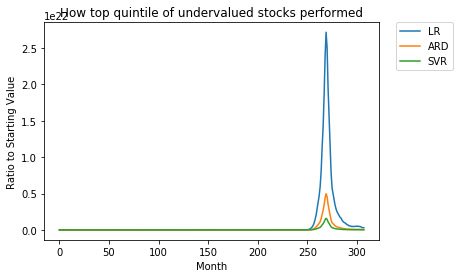

In [129]:
                            #Compare models performance through visualization
    
#plt.plot(list(total_ret_LAS[5]), label = 'LAS')
#plt.plot(list(total_ret_RID[5]), label = 'RID')
#plt.plot(list(total_ret_LR_scaled[5]), label = 'LR scaled')
#plt.plot(list(total_ret_LR_PCA[5]), label = 'LR PCA')
#plt.plot(list(total_ret_KN[5]), label = 'KN')
#plt.plot(list(total_ret_TS[5]), label = 'TS')
plt.plot(list(fo_yr_total_ret_LR[0]), label = 'LR')
plt.plot(list(fo_yr_total_ret_ARD[0]), label = 'ARD')
plt.plot(list(fo_yr_total_ret_SVR[0]), label = 'SVR')
#plt.plot(list(total_ret_RF[5]), label = 'RF')
#plt.plot(list(total_ret_con[30:]), label = 'Control')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("How top quintile of undervalued stocks performed")
plt.xlabel('Month')
plt.ylabel('Ratio to Starting Value')

In [214]:
df_class = load_obj("df_win")

In [215]:
df_class['Price']

523     79.500
943     45.250
985     56.875
1287    81.500
805     41.625
         ...  
514     28.750
543     11.040
172      7.900
610      7.980
1317     8.530
Name: Price, Length: 820086, dtype: float64

In [216]:
df_te=data_CRSP[['Date','CUSIP','Price','Returns']]
df_c = pd.merge(df_class,df_te, on = ['Date', 'CUSIP','Price'], how = 'inner')

In [217]:
save_obj(df_c, 'df_WR')

In [7]:
# creates a dictionary of stocks deemed to be under and overvalued and retrieves all further monthly data available from the CRSP dataset
#def AgnosticTrackAll(model):

def Agnostic(model):
    
    df_now = {}     #Stores all data entries for the specific month currently iterated over 
    returns={}      #Holds individual monthly returns for all stocks through 1987-2011
    returns_1 = {}  #Overvalued stock returns
    returns_2 = {}  #2nd quintile...
    returns_3 = {}
    returns_4 = {}
    returns_5 = {}

    pr_returns_1 = {}  #Overvalued stock returns
    pr_returns_2 = {}  #2nd quintile...
    pr_returns_3 = {}
    pr_returns_4 = {}
    pr_returns_5 = {}

    yr_returns_1 = {}  #Overvalued stock returns
    yr_returns_2 = {}  #2nd quintile...
    yr_returns_3 = {}
    yr_returns_4 = {}
    yr_returns_5 = {}

    fo_yr_returns_1 = {}  #Overvalued stock returns
    fo_yr_returns_2 = {}  #2nd quintile...
    fo_yr_returns_3 = {}
    fo_yr_returns_4 = {}
    fo_yr_returns_5 = {}

    portfolio = {}  #Undervalued stock returns
    df_class = load_obj('df_WR')
    qrtrs=df_class.Date.unique()      #Find all the unique quarter dates to be used in filtering data

    qrtrs.sort()

    start = time.time()
    m=0
    

    for i in range(62,len(qrtrs)-1):
        print(i)

                                 #Calculate returns from last month's portfolio
        df_now[0]=df_class[df_class['Date']==qrtrs[i]]
        for k in range(1,11):
            df_now[k] = df_class[df_class['Date']==qrtrs[i-k]] 
            cus_list[k] = list(df_now[k]['CUSIP'])
            if k==1:
                ten_sh_cus = cus_list[1]
            else:
                ten_sh_cus = list(set(ten_sh_cus) & set(cus_list[k]))
        
        for k in range(12,59):
            df_now[k] = df_class[df_class['Date']==qrtrs[i-k]] 
            cus_list[k] = list(df_now[k]['CUSIP'])
            if k==12:
                four_sh_cus = cus_list[12]
            else:
                four_sh_cus = list(set(four_sh_cus) & set(cus_list[k]))

    ###################################      1       ######################################      
        if m>0:
            
            ret=[]
            for j in range(portfolio[1]):
                if (df_now[0][df_now[0]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                    ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_1[i]=ret

            ret=[]
            for j in range(portfolio[1]):
                if (df_now[1][df_now[1]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                    ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_1[i]=ret

            ret=[]
            for j in range(portfolio[1]):
                ret_sum = 0
                for k in range(1,12):
                    if portfolio[1][j] in ten_sh_cus:
                        if (df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                            #print(df_now[k][df_now[k]['CUSIP']==sh_cus[j]]['Returns'])
                            ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0])
                #
                    #per_ret = float(df_now[0].iloc[j]['Returns'])
                ret.append(ret_sum)
            yr_returns_1[i]=ret

            ret=[]
            for j in range(portfolio[1]):
                ret_sum = 0
                for k in range(12,60):
                    if portfolio[1][j] in four_sh_cus:
                        if (df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                            ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            fo_yr_returns_1[i]=ret

    ####################################       2             ###############################     

            ret=[]
            for j in range(portfolio[2]):
                if (df_now[0][df_now[0]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                    ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_2[i]=ret

            ret=[]
            for j in range(portfolio[2]):
                if (df_now[1][df_now[1]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                    ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_2[i]=ret

            ret=[]
            for j in range(portfolio[2]):
                ret_sum = 0
                for k in range(1,12):
                    if portfolio[2][j] in ten_sh_cus:
                        if (df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                            #print(df_now[k][df_now[k]['CUSIP']==sh_cus[j]]['Returns'])
                            ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0])
                #
                    #per_ret = float(df_now[0].iloc[j]['Returns'])
                ret.append(ret_sum)
            yr_returns_2[i]=ret

            ret=[]
            for j in range(portfolio[2]):
                ret_sum = 0
                for k in range(12,60):
                    if portfolio[2][j] in four_sh_cus:
                        if (df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                            ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            fo_yr_returns_2[i]=ret

    ####################################       3             ###############################  

            ret=[]
            for j in range(portfolio[3]):
                if (df_now[0][df_now[0]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0]) != 'C':
                    ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_3[i]=ret

            ret=[]
            for j in range(portfolio[3]):
                if (df_now[1][df_now[1]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0]) != 'C':
                    ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_3[i]=ret

            ret=[]
            for j in range(portfolio[3]):
                ret_sum = 0
                for k in range(1,12):
                    if portfolio[3][j] in ten_sh_cus:
                        if (df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0]) != 'C':
                            #print(df_now[k][df_now[k]['CUSIP']==sh_cus[j]]['Returns'])
                            ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0])
                #
                    #per_ret = float(df_now[0].iloc[j]['Returns'])
                ret.append(ret_sum)
            yr_returns_3[i]=ret

            ret=[]
            for j in range(portfolio[3]):
                ret_sum = 0
                for k in range(12,60):
                    if portfolio[3][j] in four_sh_cus:
                        if (df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0]) != 'C':
                            ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            fo_yr_returns_3[i]=ret

    ####################################       4             ###############################   

            ret=[]
            for j in range(portfolio[4]):
                if (df_now[0][df_now[0]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                    ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_4[i]=ret

            ret=[]
            for j in range(portfolio[4]):
                if (df_now[1][df_now[1]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                    ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_4[i]=ret

            ret=[]
            for j in range(portfolio[4]):
                ret_sum = 0
                for k in range(1,12):
                    if portfolio[4][j] in ten_sh_cus:
                        if (df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                            #print(df_now[k][df_now[k]['CUSIP']==sh_cus[j]]['Returns'])
                            ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0])
                #
                    #per_ret = float(df_now[0].iloc[j]['Returns'])
                ret.append(ret_sum)
            yr_returns_4[i]=ret

            ret=[]
            for j in range(portfolio[4]):
                ret_sum = 0
                for k in range(12,60):
                    if portfolio[4][j] in four_sh_cus:
                        if (df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                            ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            fo_yr_returns_4[i]=ret
    ####################################       5             ###############################  

            ret=[]
            for j in range(portfolio[5]):
                if (df_now[0][df_now[0]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                    ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_5[i]=ret

            ret=[]
            for j in range(portfolio[5]):
                if (df_now[1][df_now[1]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                    ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_5[i]=ret

            ret=[]
            for j in range(portfolio[5]):
                ret_sum = 0
                for k in range(1,12):
                    if portfolio[5][j] in ten_sh_cus:
                        if (df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                            ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            yr_returns_1[5]=ret

            ret=[]
            for j in range(portfolio[5]):
                ret_sum = 0
                for k in range(12,60):
                    if portfolio[5][j] in four_sh_cus:
                        if (df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                            ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            fo_yr_returns_5[i]=ret
            

                    #Run Model to sort the stock's into quintiles based off of mispricing

        X = df_now[1].loc[:, features]   #Extract feature variable data
        X = X.fillna(X.mean())
        #X = scalar.fit_transform(X_tempscaled)
        #X = np.nan_to_num(X)
        Y = df_now[1].loc[:,['Price']].values   #Extract target data
        Y = Y.astype('float').ravel()
        #inds = [item for sublist in np.argwhere(np.isnan(Y.values)[:,0]) for item in sublist]  #indices of nan for Y
        #X_train, X_test = train_test_split(df, test_size=0.2)
        #X=X.drop(X.index[inds])
        #Y=Y.drop(Y.index[inds])

        #TPOT testing
        #start_time = time.time()
        model.fit(X, Y)
        #elapsed = time.time() - start_time
        #print(elapsed)
        #winning_pipes = winning_pipes.append(tpot.fitted_pipeline_)
        #print(tpot.score(X, Y))

        #model = MLPRegressor(hidden_layer_sizes=(15, ), activation='relu', solver='adam', alpha=0.001, batch_size='auto', learning_rate='constant', learning_rate_init=0.001, power_t=0.5, max_iter=200, shuffle=True, random_state=None, tol=0.0001, verbose=False, warm_start=False, momentum=0.9, nesterovs_momentum=True, early_stopping=False, validation_fraction=0.1, beta_1=0.9, beta_2=0.999, epsilon=1e-08)

        #model.fit(X, Y)    #Fit the data using model
        pp=model.predict(X)
        perc_dif=(pp-Y.flatten())/abs(Y.flatten())    #Calculate the percent deviation of real value from predicted value
        df_temp1=pd.DataFrame(pp)
        df_temp1.columns=['Predicted Value']
        df_temp2=pd.DataFrame(perc_dif)
        df_temp2.columns=['Percentage Deviation']
        df_model=pd.concat([df_temp1, df_temp2], axis=1) 

        result = pd.concat([df_now[1][['CUSIP','Price']].reset_index(), df_model], axis=1)  #Stores Cusip number of stock with its percent deviation, predicted price and real price in dataframe

        srted=result.sort_values(by=['Percentage Deviation'])    #Sorted verion of result
        q=round(len(srted)/5)
        q2=round(len(srted)/10)

                                            #Update the portfolio

        portfolio[1] = list(srted['CUSIP'][:q])
        portfolio[2] = list(srted['CUSIP'][q:2*q])
        portfolio[3] = list(srted['CUSIP'][2*q:3*q])
        portfolio[4] = list(srted['CUSIP'][3*q:4*q])
        if 5*q>len(srted):
            portfolio[5] = list(srted['CUSIP'][4*q:])
        portfolio[5] = list(srted['CUSIP'][4*q:5*q])

        #portfolio_1[k] = srted['CUSIP'][:q]
        #portfolio_con_3M[m] = list(srted['CUSIP'])

            #The data for this time period has processed to find under-and-overvalued stocks so we must add the to our porfolio
            #as well as look at the returns gained from stocks priorly held.  I will also do a control that tracks an even distribution investment

        m+=1
    dt=qrtrs[i]
    returns[1]=returns_1
    returns[2]=returns_2
    returns[3]=returns_3
    returns[4]=returns_4
    returns[5]=returns_5

    pr_returns = {}
    pr_returns[1]=pr_returns_1
    pr_returns[2]=pr_returns_2
    pr_returns[3]=pr_returns_3
    pr_returns[4]=pr_returns_4
    pr_returns[5]=pr_returns_5

    yr_returns = {}
    yr_returns[1]=yr_returns_1
    yr_returns[2]=yr_returns_2
    yr_returns[3]=yr_returns_3
    yr_returns[4]=yr_returns_4
    yr_returns[5]=yr_returns_5

    fo_yr_returns = {}
    fo_yr_returns[1]=fo_yr_returns_1
    fo_yr_returns[2]=fo_yr_returns_2
    fo_yr_returns[3]=fo_yr_returns_3
    fo_yr_returns[4]=fo_yr_returns_4
    fo_yr_returns[5]=fo_yr_returns_5

    ret = {}
    ret['ret'] = returns
    ret['pr'] = pr_returns
    ret['yr'] = yr_returns
    ret['fo'] = fo_yr_returns

    end = time.time()
    print(end-start)
    
    return ret

In [194]:
save_obj(returns_w10SVR, 'nreturns_w10SVR')

In [209]:
returns_LR = Agnostic(LinearRegression())

62


KeyError: "None of [Index(['Price'], dtype='object')] are in the [columns]"

In [202]:
################   Windsorize Data   ###########################

df_now = {}     #Stores all data entries for the specific month currently iterated over 
qrtrs=df.Date.unique()      #Find all the unique quarter dates to be used in filtering data
qrtrs.sort()

start = time.time()

df_cl = pd.DataFrame()
df_class = pd.DataFrame()

for i in range(4,len(qrtrs)):
    print(i)
                                    #defining the dataframe for this month
    if i>4:        
        df_now[0]=df_now[1]     
        
    df_last_qrtr=pd.DataFrame()
    df_t=data_CRSP[data_CRSP['Date']== qrtrs[i]]     
    cus_list=list(df_t['CUSIP'])
    #len(cus_list)
    for cus in cus_list:
        df_te=data_Compustat[data_Compustat['CUSIP']== cus]
        df_last_qrtr=df_last_qrtr.append(df_te[df_te['Date']==qrtrs[i]].append(df_te[df_te['Date']==qrtrs[i-1]]).append(df_te[df_te['Date']==qrtrs[i-2]]))

    x1=[]
    for row in df_last_qrtr.index: 
        x1.append(row)

    df_temp=pd.DataFrame()
    for j in x1:
        x3=data_Compustat.loc[j-3:j][IncomeCashFlowFeatures].sum()
        x3['Date']=qrtrs[i]
        x3['CUSIP']=data_Compustat.loc[j]['CUSIP']
        x4=data_Compustat.loc[j][OtherFeatures]
        x5=pd.concat([x3,x4])
        df_temp=df_temp.append(pd.DataFrame(x5).T)

    df_te=df_t[['CUSIP','Price','Returns']]
    df_now[1]=pd.merge(df_temp, df_te, on=['CUSIP'], how="inner")
    df_now[1]=df_now[1].drop_duplicates(subset='CUSIP', keep='first')          #dataframe for this month


    if i>4:    
        cus_list =     list(df_now[0]['CUSIP'])
        new_cus_list = list(df_now[1]['CUSIP'])
        df_cl = pd.DataFrame()
        for cus in cus_list:
            if cus in list(new_cus_list):
                s0 = df_now[0][df_now[0]['CUSIP']== cus]
                s1 = df_now[1][df_now[1]['CUSIP']== cus]
                s0_pr = s0.iloc[0]['Price']
                s1_pr = s1.iloc[0]['Price']
                per_ret = (s1_pr-s0_pr)/s0_pr
                s0['Ret'] = per_ret
                df_cl=df_cl.append(s0)

        q=round(len(df_cl)/5)

        df_temp1=df_cl.sort_values(by=['Ret']).iloc[:q]
        df_temp1['Class']= 1
        df_temp2=df_cl.sort_values(by=['Ret']).iloc[q:2*q]
        df_temp2['Class']= 2
        df_temp3=df_cl.sort_values(by=['Ret']).iloc[2*q:3*q]
        df_temp3['Class']= 3
        df_temp4=df_cl.sort_values(by=['Ret']).iloc[3*q:4*q]
        df_temp4['Class']= 4
        df_temp5=df_cl.sort_values(by=['Ret']).iloc[4*q:]
        df_temp5['Class']= 5

        df_class = df_class.append(df_temp1).append(df_temp2).append(df_temp3).append(df_temp4).append(df_temp5)



                                        #Update the portfolio

    #portfolio[1] = list(srted['CUSIP'][:q])
    #portfolio[2] = list(srted['CUSIP'][q:2*q])
    #portfolio[3] = list(srted['CUSIP'][2*q:3*q])
    #portfolio[4] = list(srted['CUSIP'][3*q:4*q])
    #if 5*q>len(srted):
    #    portfolio[5] = list(srted['CUSIP'][4*q:])
   # portfolio[5] = list(srted['CUSIP'][4*q:5*q])

    #portfolio_1[k] = srted['CUSIP'][:q]
    #portfolio_con_3M[m] = list(srted['CUSIP'])

        #The data for this time period has processed to find under-and-overvalued stocks so we must add the to our porfolio
        #as well as look at the returns gained from stocks priorly held.  I will also do a control that tracks an even distribution investment

end = time.time()
print(end-start)

4
5


C:\Users\Teddy\Anaconda3\lib\site-packages\ipykernel_launcher.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198


KeyboardInterrupt: 

In [ ]:
save_obj(df_class,'df_win')

In [8]:
returns_LR = load_obj('nreturns_LR')
returns_SVR = load_obj('nreturns_SVR')
#returns_scSVR = load_obj('nreturns_scSVR')
#returns_auSVR = load_obj('nreturns_auSVR')
returns_ARD = load_obj('nreturns_ARD')

In [9]:
total_ret_LR, avg_ret_LR = TotalReturns1M(returns_LR['ret'])
pr_total_ret_LR, pr_avg_ret_LR = TotalReturns1M(returns_LR['pr'])
yr_total_ret_LR, yr_avg_ret_LR = yr_TotalReturns1M(returns_LR['yr'])
fo_yr_total_ret_LR, fo_yr_avg_ret_LR = fo_TotalReturns1M(returns_LR['fo'])

#total_ret_scSVR, avg_ret_scSVR = TotalReturns1M(returns_scSVR['ret'])
#pr_total_ret_scSVR, pr_avg_ret_scSVR = TotalReturns1M(returns_scSVR['pr'])
#yr_total_ret_scSVR, yr_avg_ret_scSVR = yr_TotalReturns1M(returns_scSVR['yr'])
#fo_yr_total_ret_scSVR, fo_yr_avg_ret_scSVR = fo_TotalReturns1M(returns_scSVR['fo'])

#total_ret_auSVR, avg_ret_auSVR = TotalReturns1M(returns_auSVR['ret'])
#pr_total_ret_auSVR, pr_avg_ret_auSVR = TotalReturns1M(returns_auSVR['pr'])
#yr_total_ret_auSVR, yr_avg_ret_auSVR = yr_TotalReturns1M(returns_auSVR['yr'])
#fo_yr_total_ret_auSVR, fo_yr_avg_ret_auSVR = fo_TotalReturns1M(returns_auSVR['fo'])

#total_ret_au22SVR, avg_ret_au22SVR = TotalReturns1M(returns_au22SVR['ret'])
#pr_total_ret_au22SVR, pr_avg_ret_au22SVR = TotalReturns1M(returns_au22SVR['pr'])
#yr_total_ret_au22SVR, yr_avg_ret_au22SVR = yr_TotalReturns1M(returns_au22SVR['yr'])
#fo_yr_total_ret_au22SVR, fo_yr_avg_ret_au22SVR = fo_TotalReturns1M(returns_au22SVR['fo'])

#total_ret_au23SVR, avg_ret_au23SVR = TotalReturns1M(returns_au23SVR['ret'])
#pr_total_ret_au23SVR, pr_avg_ret_au23SVR = TotalReturns1M(returns_au23SVR['pr'])
#yr_total_ret_au23SVR, yr_avg_ret_au23SVR = yr_TotalReturns1M(returns_au23SVR['yr'])
#fo_yr_total_ret_au23SVR, fo_yr_avg_ret_au23SVR = fo_TotalReturns1M(returns_au23SVR['fo'])

#total_ret_au32SVR, avg_ret_au32SVR = TotalReturns1M(returns_au32SVR['ret'])
#pr_total_ret_au32SVR, pr_avg_ret_au32SVR = TotalReturns1M(returns_au32SVR['pr'])
#yr_total_ret_au32SVR, yr_avg_ret_au32SVR = yr_TotalReturns1M(returns_au32SVR['yr'])
#fo_yr_total_ret_au32SVR, fo_yr_avg_ret_au32SVR = fo_TotalReturns1M(returns_au32SVR['fo'])

#total_ret_ausigSVR, avg_ret_ausigSVR = TotalReturns1M(returns_ausigSVR['ret'])
#pr_total_ret_ausigSVR, pr_avg_ret_ausigSVR = TotalReturns1M(returns_ausigSVR['pr'])
#yr_total_ret_ausigSVR, yr_avg_ret_ausigSVR = yr_TotalReturns1M(returns_ausigSVR['yr'])
#fo_yr_total_ret_ausigSVR, fo_yr_avg_ret_ausigSVR = fo_TotalReturns1M(returns_ausigSVR['fo'])

#total_ret_ARD, avg_ret_ARD = TotalReturns1M(returns_ARD['ret'])
#pr_total_ret_ARD, pr_avg_ret_ARD = TotalReturns1M(returns_ARD['pr'])
#yr_total_ret_ARD, yr_avg_ret_ARD = yr_TotalReturns1M(returns_ARD['yr'])
#fo_yr_total_ret_ARD, fo_yr_avg_ret_ARD = fo_TotalReturns1M(returns_ARD['fo'])


#total_ret_w10SVR, avg_ret_w10SVR = ten_TotalReturns1M(returns_w10SVR['ret'])


KeyError: 309

Text(0, 0.5, 'Ratio to Starting Value')

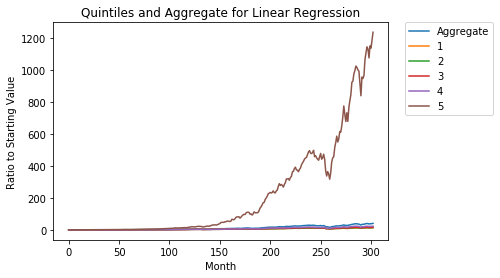

In [336]:
                                    #Plot of individual quintiles
plt.plot(list(total_ret_LR[0]), label = 'Aggregate')
plt.plot(list(total_ret_LR[1]), label = '1')
plt.plot(list(total_ret_LR[2]), label = '2')
plt.plot(list(total_ret_LR[3]), label = '3')
plt.plot(list(total_ret_LR[4]), label = '4')
plt.plot(list(total_ret_LR[5]), label = '5')

#plt.plot(list(total_ret_LR_PCA[5][:100]), label = 'PCA')
#plt.plot(list(total_ret_ARD[5][:100]), label = 'ARD 5')
#plt.plot(list(total_ret_con[30:]), label = 'Control')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Quintiles and Aggregate for Linear Regression")
plt.xlabel('Month')
plt.ylabel('Ratio to Starting Value')

In [199]:
#Quantify the performance of the models in each quintile and control
models = [avg_ret_w10SVR]

import inspect, re

def namestr(obj, namespace):
    return [name for name in namespace if namespace[name] is obj]
    
for j in models:
    print(namestr(j,globals()),':')
    for i in range(0,6):
        print(np.mean(j[i]))

['j', 'avg_ret_w10SVR'] :
1.0096508494006884
0.99675822992984
1.0055925862218054
1.0082845996964616
1.0098028619493353
1.0278159692060005


In [337]:
#Quantify the performance of the models in each quintile and control
models = [avg_ret_LR, pr_avg_ret_LR, yr_avg_ret_LR, fo_yr_avg_ret_LR]

import inspect, re

def namestr(obj, namespace):
    return [name for name in namespace if namespace[name] is obj]
    
for j in models:
    print(namestr(j,globals()),':')
    for i in range(0,6):
        print(np.mean(j[i]))

['avg_ret_LR', 'j'] :
1.0137055125610057
1.0099310328190643
1.0101924828193123
1.0108279743584365
1.012261364065292
1.0253147087429235
['pr_avg_ret_LR', 'j'] :
1.0144403797237889
1.009726627047545
1.0100714523586685
1.0110140687255766
1.0123069251214718
1.0290828253656834
['yr_avg_ret_LR', 'j'] :
1.120341844207029
1.2391234389523267
1.1783096442240102
1.1356268609757245
1.0749760620052762
0.9736732148778079
['fo_yr_avg_ret_LR', 'j'] :
1.3626017449400007
1.580740304654765
1.4949024108826494
1.3764093697949138
1.2457308791079884
1.1152257602596864


Text(0, 0.5, 'Ratio to Starting Value')

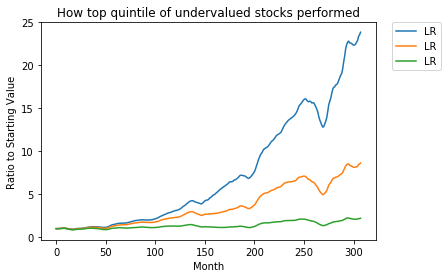

In [136]:
                            #Compare models performance through visualization
    
#plt.plot(list(total_ret_LAS[5]), label = 'LAS')
#plt.plot(list(total_ret_RID[5]), label = 'RID')
#plt.plot(list(total_ret_LR_scaled[5]), label = 'LR scaled')
#plt.plot(list(total_ret_LR_PCA[5]), label = 'LR PCA')
#plt.plot(list(total_ret_KN[5]), label = 'KN')
#plt.plot(list(total_ret_TS[5]), label = 'TS')
#plt.plot(list(yr_total_ret_LR[1]), label = 'LR')
plt.plot(list(yr_total_ret_LR[2]), label = 'LR')
plt.plot(list(yr_total_ret_LR[3]), label = 'LR')
plt.plot(list(yr_total_ret_LR[4]), label = 'LR')
#plt.plot(list(yr_total_ret_LR[5]), label = 'LR')
#plt.plot(list(total_ret_ARD[5]), label = 'ARD')
#plt.plot(list(total_ret_SVR[5]), label = 'SVR')
#plt.plot(list(total_ret_RF[5]), label = 'RF')
#plt.plot(list(total_ret_con[30:]), label = 'Control')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("How top quintile of undervalued stocks performed")
plt.xlabel('Month')
plt.ylabel('Ratio to Starting Value')

Text(0, 0.5, 'Ratio to Starting Value')

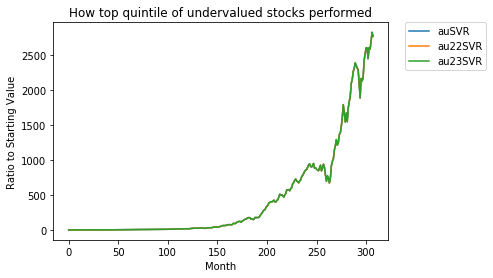

In [185]:
                            #Compare models performance through visualization
    
#plt.plot(list(total_ret_LAS[5]), label = 'LAS')
#plt.plot(list(total_ret_RID[5]), label = 'RID')
#plt.plot(list(total_ret_LR_scaled[5]), label = 'LR scaled')
#plt.plot(list(total_ret_LR_PCA[5]), label = 'LR PCA')
#plt.plot(list(total_ret_KN[5]), label = 'KN')
#plt.plot(list(total_ret_TS[5]), label = 'TS')
#plt.plot(list(total_ret_LR[0]), label = 'LR')
#plt.plot(list(total_ret_ARD[5]), label = 'ARD')
#plt.plot(list(total_ret_scSVR[5]), label = 'scSVR')
plt.plot(list(total_ret_auSVR[5]), label = 'auSVR')
plt.plot(list(total_ret_au22SVR[5]), label = 'au22SVR')
plt.plot(list(total_ret_au23SVR[5]), label = 'au23SVR')
#plt.plot(list(total_ret_au32SVR[5]), label = 'au32SVR')
#plt.plot(list(total_ret_ausigSVR[5]), label = 'ausigSVR')
#plt.plot(list(total_ret_RF[5]), label = 'RF')
#plt.plot(list(total_ret_con[30:]), label = 'Control')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("How top quintile of undervalued stocks performed")
plt.xlabel('Month')
plt.ylabel('Ratio to Starting Value')

In [71]:
x1 = [1]
for i in range(1,len(yr_avg_ret_SVR[1])-12):
    x1.append(x1[i-1]*yr_avg_ret_SVR[1][12+i])
    
    

In [86]:
returns_SVR['ret'][2]

{1: [-0.058823529411764705,
  -0.041666666666666664,
  -0.041666666666666664,
  -0.08333333333333333,
  -0.020833333333333332,
  -0.1284722222222222,
  -0.4513888888888889,
  -0.40625,
  0.1254355400696864,
  0.34057971014492755,
  -0.0034965034965034965,
  -0.03496503496503497,
  -0.12237762237762238,
  -0.5368421052631579,
  -0.0456140350877193,
  -0.08421052631578947,
  0.0035087719298245615,
  -0.007017543859649123,
  0.13333333333333333,
  -0.056338028169014086,
  -0.11267605633802817,
  -0.0035211267605633804,
  -0.053003533568904596,
  0.0,
  0.15901060070671377,
  0.0035460992907801418,
  -0.11702127659574468,
  -0.06382978723404255,
  -0.08156028368794327,
  -0.0851063829787234,
  -0.010638297872340425,
  -0.014184397163120567,
  -0.09219858156028368,
  -0.2556053811659193,
  -0.06405693950177936,
  0.05693950177935943,
  -0.042704626334519574,
  -0.02491103202846975,
  -0.039285714285714285,
  0.11428571428571428,
  -0.014285714285714285,
  -0.07142857142857142,
  0.057142857

In [202]:
np.mean(avg_ret_w10SVR[10])

1.042173300479359

In [203]:
1.042**300

229253.3491913251

In [148]:
# creates a dictionary of stocks deemed to be under and overvalued and retrieves all further monthly data available from the CRSP dataset
#def AgnosticTrackAll(model):
from sklearn.utils import shuffle

def divAgnostic(model):
    
    df_now = {}     #Stores all data entries for the specific month currently iterated over 
    returns={}
    portfolio = {}  #Undervalued stock returns
    
    returns_0 = {}
    returns_2 = {}
    returns_4 = {}
    returns_6 = {}
    returns_8 = {}
    returns_10 = {}
    returns_12 = {}
    returns_14 = {}
    returns_16 = {}
    returns_18 = {}
    returns_20 = {}
    returns_22 = {}
    returns_24 = {}
    returns_26 = {}
    returns_28 = {}
    returns_30 = {}
    returns_32 = {}
    returns_34 = {}
    returns_36 = {}
    returns_38 = {}
    returns_40 = {}
    returns_50 = {}
    returns_60 = {}
    returns_80 = {}

    qrtrs=df.Date.unique()      #Find all the unique quarter dates to be used in filtering data

    qrtrs.sort()

    start = time.time()
    m=0

    df_class = load_obj('df_win')
    for i in range(62,len(qrtrs)-1):
        print(i)

                                 #Calculate returns from last month's portfolio
        df_now[0] = df_class[df_class['Date']==qrtrs[i-1]] 
        df_now[1] = df_class[df_class['Date']==qrtrs[i]]

        if m>0:
            ret=[]
            for j in range(0,len(portfolio[0])):
                if portfolio[0][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[0][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[0][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_0[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[2])):
                if portfolio[2][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[2][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[2][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_2[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[4])):
                if portfolio[4][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[4][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[4][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_4[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[6])):
                if portfolio[6][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[6][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[6][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_6[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[8])):
                if portfolio[8][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[8][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[8][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_8[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[10])):
                if portfolio[10][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[10][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[10][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_10[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[12])):
                if portfolio[12][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[12][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[12][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_12[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[14])):
                if portfolio[14][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[14][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[14][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_14[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[16])):
                if portfolio[16][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[16][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[16][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_16[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[18])):
                if portfolio[18][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[18][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[18][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_18[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[20])):
                if portfolio[20][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[20][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[20][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_20[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[22])):
                if portfolio[22][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[22][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[22][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_22[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[24])):
                if portfolio[24][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[24][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[24][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_24[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[26])):
                if portfolio[26][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[26][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[26][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_26[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[28])):
                if portfolio[28][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[28][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[28][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_28[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[30])):
                if portfolio[30][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[30][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[30][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_30[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[32])):
                if portfolio[32][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[32][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[32][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_32[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[34])):
                if portfolio[34][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[34][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[34][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_34[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[36])):
                if portfolio[36][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[36][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[36][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_36[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[38])):
                if portfolio[38][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[38][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[38][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_38[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[40])):
                if portfolio[40][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[40][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[40][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_40[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[50])):
                if portfolio[50][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[50][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[50][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_50[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[60])):
                if portfolio[60][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[60][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[60][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_60[m]=ret
            
            ret=[]
            for j in range(0,len(portfolio[80])):
                if portfolio[80][j] in list(df_now[1]['CUSIP']):
                    or_pr = float(list(df_now[0][df_now[0]['CUSIP']== portfolio[80][j]]['Price'])[0])
                    new_pr = float(list(df_now[1][df_now[1]['CUSIP']== portfolio[80][j]]['Price'])[0])
                    per_ret = (new_pr-or_pr)/or_pr 
                    ret.append(per_ret)
            returns_80[m]=ret
            

                



                    #Run Model to sort the stock's into quintiles based off of mispricing

        X = df_now[1].loc[:, features]   #Extract feature variable data
        X = X.fillna(X.mean())
        #X = scalar.fit_transform(X_tempscaled)
        #X = np.nan_to_num(X)
        Y = df_now[1].loc[:,['Price']].values   #Extract target data
        Y = Y.astype('float').ravel()
        #inds = [item for sublist in np.argwhere(np.isnan(Y.values)[:,0]) for item in sublist]  #indices of nan for Y
        #X_train, X_test = train_test_split(df, test_size=0.2)
        #X=X.drop(X.index[inds])
        #Y=Y.drop(Y.index[inds])

        #TPOT testing
        #start_time = time.time()
        X, Y = shuffle(X, Y)
        model.fit(X, Y)
        #elapsed = time.time() - start_time
        #print(elapsed)
        #winning_pipes = winning_pipes.append(tpot.fitted_pipeline_)
        #print(tpot.score(X, Y))

        #model = MLPRegressor(hidden_layer_sizes=(15, ), activation='relu', solver='adam', alpha=0.001, batch_size='auto', learning_rate='constant', learning_rate_init=0.001, power_t=0.5, max_iter=200, shuffle=True, random_state=None, tol=0.0001, verbose=False, warm_start=False, momentum=0.9, nesterovs_momentum=True, early_stopping=False, validation_fraction=0.1, beta_1=0.9, beta_2=0.999, epsilon=1e-08)

        #model.fit(X, Y)    #Fit the data using model
        pp=model.predict(X)
        perc_dif=(pp-Y.flatten())/abs(Y.flatten())    #Calculate the percent deviation of real value from predicted value
        df_temp1=pd.DataFrame(pp)
        df_temp1.columns=['Predicted Value']
        df_temp2=pd.DataFrame(perc_dif)
        df_temp2.columns=['Percentage Deviation']
        df_model=pd.concat([df_temp1, df_temp2], axis=1) 

        result = pd.concat([df_now[1][['CUSIP','Price']].reset_index(), df_model], axis=1)  #Stores Cusip number of stock with its percent deviation, predicted price and real price in dataframe

        srted=result.sort_values(by=['Percentage Deviation'])    #Sorted verion of result
        
        portfolio[0] = list(srted['CUSIP'])
        for k in range(2,41,2):
            q=round(len(srted)/k)                                           
            portfolio[k] = list(srted['CUSIP'][-q:])
            
        for k in [50,60,80]:
            q=round(len(srted)/k)                                           
            portfolio[k] = list(srted['CUSIP'][-q:])

        m+=1
    dt=qrtrs[i]
    
    returns[0]=returns_0
    returns[2]=returns_2
    returns[4]=returns_4
    returns[6]=returns_6
    returns[8]=returns_8
    returns[10]=returns_10
    returns[12]=returns_12
    returns[14]=returns_14
    returns[16]=returns_16
    returns[18]=returns_18
    returns[20]=returns_20
    returns[22]=returns_22
    returns[24]=returns_24
    returns[26]=returns_26
    returns[28]=returns_28
    returns[30]=returns_30
    returns[32]=returns_32
    returns[34]=returns_34
    returns[36]=returns_36
    returns[38]=returns_38
    returns[40]=returns_40
    returns[50]=returns_50
    returns[60]=returns_60
    returns[80]=returns_80
    end = time.time()
    print(end-start)
    
    return returns

In [150]:
returns_divSVR2 = divAgnostic(svm.SVR(gamma='auto'))

62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
32

In [149]:
save_obj(returns_divSVR,'returns_divSVR')

In [10]:
def divTotalReturns1M(returns):
    
    total_ret_00=[1]
    total_ret_0=[1]
    total_ret_1=[1]  
    total_ret_2=[1]
    total_ret_3=[1]
    total_ret_4=[1]
    total_ret_5=[1]  
    total_ret_6=[1]
    total_ret_7=[1]
    total_ret_8=[1]
    total_ret_9=[1]
    total_ret_10=[1]
    total_ret_11=[1]  
    total_ret_12=[1]
    total_ret_13=[1]
    total_ret_14=[1]
    total_ret_15=[1]  
    total_ret_16=[1]
    total_ret_17=[1]
    total_ret_18=[1]
    total_ret_19=[1]
    total_ret_20=[1]
    total_ret_21=[1]
    total_ret_22=[1]
    
    avg_ret_00=[1]
    avg_ret_0=[1]
    avg_ret_1=[1]
    avg_ret_2=[1]
    avg_ret_3=[1]
    avg_ret_4=[1]
    avg_ret_5=[1]
    avg_ret_6=[1]
    avg_ret_7=[1]
    avg_ret_8=[1]
    avg_ret_9=[1]
    avg_ret_10=[1]
    avg_ret_11=[1]
    avg_ret_12=[1]
    avg_ret_13=[1]
    avg_ret_14=[1]
    avg_ret_15=[1]
    avg_ret_16=[1]
    avg_ret_17=[1]
    avg_ret_18=[1]
    avg_ret_19=[1]
    avg_ret_20=[1]
    avg_ret_21=[1]
    avg_ret_22=[1]
    

    i=1
    for j in range(1,len(returns[4])):
        avg_ret_00.append(1 + np.mean(returns[0][i]))
        total_ret_00.append(avg_ret_00[j]*total_ret_00[j-1])
        avg_ret_0.append(1 + np.mean(returns[2][i]))
        total_ret_0.append(avg_ret_0[j]*total_ret_0[j-1])
        avg_ret_1.append(1 + np.mean(returns[4][i]))
        total_ret_1.append(avg_ret_1[j]*total_ret_1[j-1])
        avg_ret_2.append(1+np.mean(returns[6][i]))
        total_ret_2.append(avg_ret_2[j]*total_ret_2[j-1])
        avg_ret_3.append(1+np.mean(returns[8][i]))
        total_ret_3.append(avg_ret_3[j]*total_ret_3[j-1])
        avg_ret_4.append(1+np.mean(returns[10][i]))
        total_ret_4.append(avg_ret_4[j]*total_ret_4[j-1])
        avg_ret_5.append(1+np.mean(returns[12][i]))
        total_ret_5.append(avg_ret_5[j]*total_ret_5[j-1])
        avg_ret_6.append(1+np.mean(returns[14][i]))
        total_ret_6.append(avg_ret_6[j]*total_ret_6[j-1])
        avg_ret_7.append(1+np.mean(returns[16][i]))
        total_ret_7.append(avg_ret_7[j]*total_ret_7[j-1])
        avg_ret_8.append(1+np.mean(returns[18][i]))
        total_ret_8.append(avg_ret_8[j]*total_ret_8[j-1])
        avg_ret_9.append(1+np.mean(returns[20][i]))
        total_ret_9.append(avg_ret_9[j]*total_ret_9[j-1])
        avg_ret_10.append(1 + np.mean(returns[22][i]))
        total_ret_10.append(avg_ret_10[j]*total_ret_10[j-1])
        avg_ret_11.append(1+np.mean(returns[24][i]))
        total_ret_11.append(avg_ret_11[j]*total_ret_11[j-1])
        avg_ret_12.append(1+np.mean(returns[26][i]))
        total_ret_12.append(avg_ret_12[j]*total_ret_12[j-1])
        avg_ret_13.append(1+np.mean(returns[28][i]))
        total_ret_13.append(avg_ret_13[j]*total_ret_13[j-1])
        avg_ret_14.append(1+np.mean(returns[30][i]))
        total_ret_14.append(avg_ret_14[j]*total_ret_14[j-1])
        avg_ret_15.append(1+np.mean(returns[32][i]))
        total_ret_15.append(avg_ret_15[j]*total_ret_15[j-1])
        avg_ret_16.append(1+np.mean(returns[34][i]))
        total_ret_16.append(avg_ret_16[j]*total_ret_16[j-1])
        avg_ret_17.append(1+np.mean(returns[36][i]))
        total_ret_17.append(avg_ret_17[j]*total_ret_17[j-1])
        avg_ret_18.append(1+np.mean(returns[38][i]))
        total_ret_18.append(avg_ret_18[j]*total_ret_18[j-1])
        avg_ret_19.append(1+np.mean(returns[40][i]))
        total_ret_19.append(avg_ret_19[j]*total_ret_19[j-1])
        avg_ret_20.append(1+np.mean(returns[50][i]))
        total_ret_20.append(avg_ret_20[j]*total_ret_20[j-1])
        avg_ret_21.append(1+np.mean(returns[60][i]))
        total_ret_21.append(avg_ret_21[j]*total_ret_21[j-1])
        avg_ret_22.append(1+np.mean(returns[80][i]))
        total_ret_22.append(avg_ret_22[j]*total_ret_22[j-1])
 
        i+=1
    
    total_ret={}
    total_ret[23]=total_ret_00
    total_ret[0]=total_ret_0
    total_ret[1]=total_ret_1
    total_ret[2]=total_ret_2
    total_ret[3]=total_ret_3
    total_ret[4]=total_ret_4
    total_ret[5]=total_ret_5
    total_ret[6]=total_ret_6
    total_ret[7]=total_ret_7
    total_ret[8]=total_ret_8
    total_ret[9]=total_ret_9
    total_ret[10]=total_ret_10
    total_ret[11]=total_ret_11
    total_ret[12]=total_ret_12
    total_ret[13]=total_ret_13
    total_ret[14]=total_ret_14
    total_ret[15]=total_ret_15
    total_ret[16]=total_ret_16
    total_ret[17]=total_ret_17
    total_ret[18]=total_ret_18
    total_ret[19]=total_ret_19
    total_ret[20]=total_ret_20
    total_ret[21]=total_ret_21
    total_ret[22]=total_ret_22

    
    avg_ret={}
    avg_ret[23]=avg_ret_00
    avg_ret[0]=avg_ret_00
    avg_ret[1]=avg_ret_1
    avg_ret[2]=avg_ret_2
    avg_ret[3]=avg_ret_3
    avg_ret[4]=avg_ret_4
    avg_ret[5]=avg_ret_5
    avg_ret[6]=avg_ret_6
    avg_ret[7]=avg_ret_7
    avg_ret[8]=avg_ret_8
    avg_ret[9]=avg_ret_9
    avg_ret[10]=avg_ret_10        
    avg_ret[11]=avg_ret_11
    avg_ret[12]=avg_ret_12
    avg_ret[13]=avg_ret_13
    avg_ret[14]=avg_ret_14
    avg_ret[15]=avg_ret_15
    avg_ret[16]=avg_ret_16
    avg_ret[17]=avg_ret_17
    avg_ret[18]=avg_ret_18
    avg_ret[19]=avg_ret_19
    avg_ret[20]=avg_ret_20
    avg_ret[21]=avg_ret_21
    avg_ret[22]=avg_ret_22
    
    return total_ret, avg_ret

In [151]:
total_ret_divSVR, avg_ret_divSVR = divTotalReturns1M(returns_divSVR)

Text(0, 0.5, 'Ratio to Starting Value')

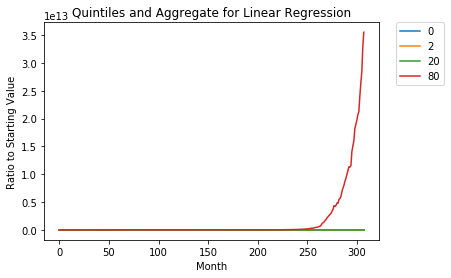

In [152]:
plt.plot(list(total_ret_divSVR[23]), label = '0')
plt.plot(list(total_ret_divSVR[0]), label = '2')
#plt.plot(list(total_ret_divSVR[1]), label = '4')
#plt.plot(list(total_ret_divSVR[2]), label = '6')
#plt.plot(list(total_ret_divSVR[3]), label = '8')
#plt.plot(list(total_ret_divSVR[4]), label = '10')
#plt.plot(list(total_ret_divSVR[5]), label = '12')
#plt.plot(list(total_ret_divSVR[6]), label = '14')
#plt.plot(list(total_ret_divSVR[7]), label = '16')
#plt.plot(list(total_ret_divSVR[8]), label = '18')
plt.plot(list(total_ret_divSVR[9]), label = '20')
#plt.plot(list(total_ret_divSVR[10]), label = '22')
#plt.plot(list(total_ret_divSVR[11]), label = '24')
#plt.plot(list(total_ret_divSVR[12]), label = '26')
#plt.plot(list(total_ret_divSVR[13]), label = '28')
#plt.plot(list(total_ret_divSVR[14]), label = '30')
#plt.plot(list(total_ret_divSVR[15]), label = '32')
#plt.plot(list(total_ret_divSVR[16]), label = '34')
#plt.plot(list(total_ret_divSVR[17]), label = '36')
#plt.plot(list(total_ret_divSVR[18]), label = '38')
#plt.plot(list(total_ret_divSVR[19]), label = '40')
#plt.plot(list(total_ret_divSVR[20]), label = '50')
#plt.plot(list(total_ret_divSVR[21]), label = '60')
plt.plot(list(total_ret_divSVR[22]), label = '80')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Quintiles and Aggregate for Linear Regression")
plt.xlabel('Month')
plt.ylabel('Ratio to Starting Value')

In [58]:
l=[]
for j in avg_ret_divSVR:
    l.append(np.mean(avg_ret_divSVR[j]))

In [57]:
l=[]
for x in range(0,len(returns_divSVR[20])):
    l.append(np.mean(returns_divSVR[20][x]))

KeyError: 0

W0123 16:50:00.203063 14872 legend.py:1282] No handles with labels found to put in legend.


Text(0, 0.5, 'Mean Return')

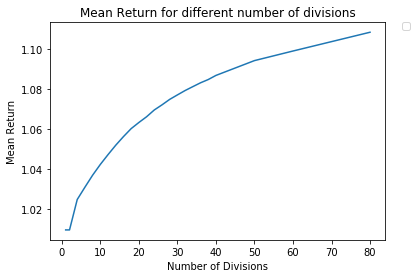

In [153]:
k=[1,2,4,6,8,10,12,14,16,18,20,22,24,26,28,30,32,34,36,38,40,50,60,80]
plt.plot(k,l)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Mean Return for different number of divisions")
plt.xlabel('Number of Divisions')
plt.ylabel('Mean Return')

In [154]:
l

[1.0093595719312825,
 1.0093595719312825,
 1.024584472584894,
 1.0307712350022162,
 1.0367878864670443,
 1.042173300479359,
 1.0470903589148233,
 1.0517968970546188,
 1.0561020666646055,
 1.0601040452963855,
 1.0631711457585638,
 1.0660429574439598,
 1.0694429890895472,
 1.0720056821274018,
 1.0747528288978643,
 1.0769863907810562,
 1.0791810583042143,
 1.081127114606615,
 1.0830528116426368,
 1.0846835454485786,
 1.086749360555927,
 1.0941753194706134,
 1.098976883950284,
 1.1083811080983765]

In [69]:
x = {}
for j in range(0,21,2):
    x[j]=[]
    for i in range(1,len(returns_divSVR[j])):       
        x[j].append(np.mean(returns_divSVR[j][i]))

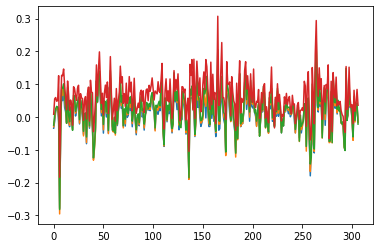

In [77]:
plt.plot(x[0])
plt.plot(x[2])
plt.plot(x[4])
plt.plot(x[20])

In [83]:
returns_divSVR[10][1]

[-0.2698412698412698,
 -0.09523809523809523,
 0.047619047619047616,
 0.07936507936507936,
 -0.06349206349206349,
 0.09523809523809523,
 -0.09523809523809523,
 -0.14285714285714285,
 0.0,
 -0.15873015873015872,
 0.047619047619047616,
 -0.015873015873015872,
 -0.04918032786885246,
 -0.04918032786885246,
 -0.0967741935483871,
 -0.03225806451612903,
 -0.16129032258064516,
 -0.06451612903225806,
 -0.0967741935483871,
 0.0967741935483871,
 -0.11290322580645161,
 0.016129032258064516,
 0.12903225806451613,
 -0.08064516129032258,
 0.3387096774193548,
 -0.16129032258064516,
 0.08064516129032258,
 -0.016129032258064516,
 0.03225806451612903,
 -0.18032786885245902,
 -0.14754098360655737,
 -0.09836065573770492,
 -0.04918032786885246,
 -0.04918032786885246,
 -0.04918032786885246,
 0.04918032786885246,
 -0.04918032786885246,
 -0.1,
 0.017857142857142856,
 -0.06666666666666667,
 0.034482758620689655,
 0.1,
 -0.03333333333333333,
 0.0,
 0.1,
 0.05,
 -0.1,
 0.03333333333333333,
 0.03333333333333333,
 0

W0123 16:50:41.043943 14872 legend.py:1282] No handles with labels found to put in legend.


Text(0, 0.5, 'Return')

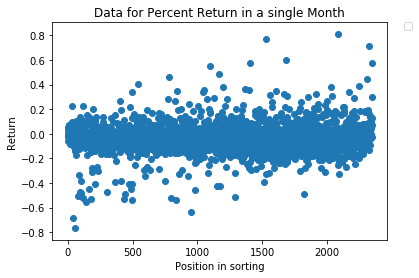

In [155]:
plt.scatter(range(len(returns_divSVR[0][1])),returns_divSVR[0][1])
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Data for Percent Return in a single Month")
plt.xlabel('Position in sorting')
plt.ylabel('Return')

W0123 16:50:46.366223 14872 legend.py:1282] No handles with labels found to put in legend.


Text(0, 0.5, 'Return')

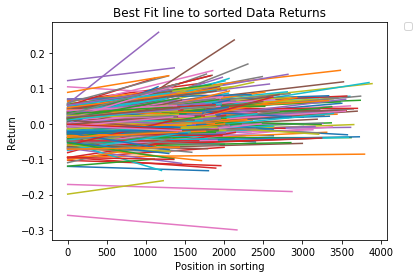

In [156]:
m=[]
for p in range(1,len(returns_divSVR[0])):
    x = range(len(returns_divSVR[0][p]))
    y=returns_divSVR[0][p]
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)))
    m.append(np.polyfit(x, y, 1)[0])
    
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Best Fit line to sorted Data Returns")
plt.xlabel('Position in sorting')
plt.ylabel('Return')

In [98]:
np.mean(m)

1.6529623311268956e-05

W0123 13:43:22.760814 14872 legend.py:1282] No handles with labels found to put in legend.


Text(0, 0.5, 'Return')

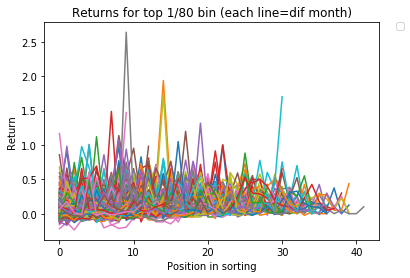

In [147]:
for p in range(1,len(returns_divSVR[80])):
    plt.plot(returns_divSVR[80][p])
    
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Returns for top 1/80 bin (each line=dif month)")
plt.xlabel('Position in sorting')
plt.ylabel('Return')

W0123 13:42:41.192020 14872 legend.py:1282] No handles with labels found to put in legend.


Text(0, 0.5, 'Return')

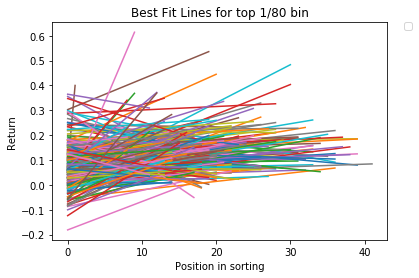

In [146]:
m=[]
for p in range(1,len(returns_divSVR[80])):
    x = range(len(returns_divSVR[80][p]))
    y=returns_divSVR[80][p]
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)))
    m.append(np.polyfit(x, y, 1)[0])
    
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Best Fit Lines for top 1/80 bin")
plt.xlabel('Position in sorting')
plt.ylabel('Return')

In [17]:
returns_LR['fo']

{1: {1: [-0.21674876847290642,
   0.3877551020408163,
   0.3373860182370821,
   0.422360248447205,
   -0.18584070796460178,
   2.2731591448931114,
   4.037037037037037,
   2.1973684210526314,
   1.733644859813084,
   2.35,
   -0.37545126353790614,
   2.8541666666666665,
   4.840909090909091,
   3.5052631578947366,
   1.2950819672131149,
   3.2045454545454546,
   3.9655172413793105,
   0.23986486486486486,
   1.745644599303136,
   0.7217741935483871,
   2.763888888888889,
   0.5176056338028169,
   0.3310344827586207,
   2.577639751552795,
   0.49063670411985016,
   0.39661016949152544,
   1.6551724137931034,
   0.5828571428571429,
   6.647058823529412,
   0.6311787072243346,
   0.470954356846473,
   2.4953271028037385,
   1.4029126213592233,
   0.4114391143911439,
   2.6535433070866143,
   1.2897727272727273,
   2.440894568690096,
   1.107843137254902,
   0.6611694152923538,
   1.236503856041131,
   0.3062200956937799,
   0.5611111111111111,
   1.2950819672131149,
   0.6026200873362445,

In [30]:
avgs = {}
for n in returns_LR:
    avgs[n]=[]
    for i in returns_LR[n]:
        for j in returns_LR[n][i]:
            for k in returns_LR[n][i][j]:
                avgs[n].append(k)
            

In [25]:
len(l)

432143

In [32]:
for k in avgs:
    print(np.mean(avgs[k]))

0.010020898278192284
0.010036865673093311
0.07217916199668738
0.24502300934346216


In [34]:
pd.DataFrame(returns_LR['ret'])

,1,2,3,4,5
1,"[0.06976744186046512, 0.1125, -0.0215827338129...","[-0.026615969581749048, -0.06358381502890173, ...","[-0.0989010989010989, -0.03488372093023256, 0....","[0.06818181818181818, -0.13846153846153847, -0...","[-0.17073170731707318, 0.024390243902439025, -..."
2,"[-0.007352941176470588, 0.021739130434782608, ...","[-0.04897959183673469, -0.016152716593245228, ...","[-0.056818181818181816, -0.07027027027027027, ...","[-0.3114754098360656, 0.0, -0.4975845410628019...","[-0.05, 0.0, -0.04819277108433735, -0.2, 0.125..."
3,"[-0.037037037037037035, -0.04513888888888889, ...","[-0.1652892561983471, 0.05755395683453238, 0.0...","[-0.08421052631578947, 0.0430622009569378, 0.1...","[0.18461538461538463, 0.0, 0.04545454545454545...","[0.038461538461538464, 0.025974025974025976, 0..."
4,"[-0.06153846153846154, 0.36727272727272725, 0....","[-0.05737704918032787, 0.3515625, 0.1845493562...","[0.011764705882352941, -0.024390243902439025, ...","[-0.05172413793103448, -0.09482758620689655, 0...","[0.2692307692307692, 0.05405405405405406, 0.05..."
5,"[-0.0398936170212766, -0.10546875, 0.021645021...","[0.1037463976945245, -0.027522935779816515, 0....","[0.13609467455621302, 0.09411764705882353, 0.1...","[0.00847457627118644, -0.36134453781512604, 0....","[0.08641975308641975, 0.06666666666666667, 0.1..."
6,"[0.2077562326869806, 0.1615720524017467, -0.13...","[0.1540785498489426, 0.0234375, -0.18888888888...","[-0.03333333333333333, 0.06349206349206349, 0....","[-0.06557377049180328, -0.16393442622950818, 0...","[0.1506849315068493, -0.025, 0.126582278481012..."
7,"[-0.09565217391304348, -0.20388349514563106, -...","[-0.2313167259786477, -0.38823529411764707, -0...","[-0.25, -0.27014218009478674, -0.3369565217391...","[-0.3237410071942446, -0.3023255813953488, -0....","[-0.29357798165137616, -0.2391304347826087, -0..."
8,"[-0.057692307692307696, -0.11864406779661017, ...","[-0.020833333333333332, -0.20833333333333334, ...","[0.0684931506849315, -0.07142857142857142, -0....","[-0.1972318339100346, -0.27358490566037735, -0...","[0.03076923076923077, -0.17142857142857143, -0..."
9,"[-0.02040816326530612, 0.28205128205128205, -0...","[0.24210526315789474, -0.05714285714285714, 0....","[0.04216867469879518, 0.15384615384615385, 0.1...","[0.043478260869565216, 0.16666666666666666, 0....","[0.46774193548387094, 0.0, 0.03225806451612903..."
10,"[0.01, -0.07446808510638298, 0.057522123893805...","[0.056074766355140186, 0.09090909090909091, 0....","[0.050359712230215826, -0.0056179775280898875,...","[0.049019607843137254, 0.11458333333333333, 0....","[0.029411764705882353, 0.171875, -0.1159420289..."


In [47]:
i=63    
qrtrs=df.Date.unique()      #Find all the unique quarter dates to be used in filtering data
qrtrs.sort()
df_now={}
df_now[11] = df_class[df_class['Date']==qrtrs[i-2]] 
df_now[0] = df_class[df_class['Date']==qrtrs[i-1]] 
df_now[1] = df_class[df_class['Date']==qrtrs[i]]
df_now[12] = df_class[df_class['Date']==qrtrs[i-11]]
df_now[48] = df_class[df_class['Date']==qrtrs[i-59]]

In [48]:
df_now[0]['Date']

1101    198703
2025    198703
1297    198703
1608    198703
2079    198703
         ...  
236     198703
2002    198703
699     198703
191     198703
377     198703
Name: Date, Length: 2460, dtype: object

In [65]:
df_now[48]

,Dividends - Preferred/Preference,Cash and Short-Term Investments,Sales/Turnover (Net),Net Income (Loss),Income Before Extraordinary Items - Adjusted for Common Stock Equivalents,Income Before Extraordinary Items - Available for Common,Income Before Extraordinary Items,Pretax Income,Cash Dividends,Income Taxes - Total,...,Liabilities - Other,Liabilities - Total,Property Plant and Equipment - Total (Net),Preferred/Preference Stock (Capital) - Total,Preferred/Preference Stock - Redeemable,Stockholders Equity > Parent > Index Fundamental > Quarterly,Stockholders Equity - Total,Price,Ret,Class
523,0,59.954,133.823,5.45,2.508,2.508,2.508,7.113,0,4.605,...,0,40.962,54.101,0,0,66.307,NaN,79.500,-0.542453,1
943,0,46.108,541.972,8.842,8.842,8.842,8.842,17.094,0.675,8.252,...,0,229.672,118.288,0,0,197.818,NaN,45.250,-0.538674,1
985,4.072,85.712,348.789,2.427,-1.645,-1.645,2.427,4.891,9.416,2.464,...,2.58,13.455,14.448,0,0,71.134,NaN,56.875,-0.529670,1
1287,4.173,2338.92,4312.06,416.862,413.689,413.689,417.862,615.09,195.326,195.407,...,NaN,3282.9,38,0,0,967.7,NaN,81.500,-0.523006,1
805,0,1271.75,2925.21,77.556,77.256,77.256,77.256,85.275,1.452,8.019,...,NaN,22561.3,101.9,0,0,2787.7,NaN,41.625,-0.483483,1
1244,0,33.761,50.547,19.784,19.784,19.784,19.784,20.348,61.763,0.568,...,0,151.368,141.489,0,0,9.499,9.499,9.875,-0.443038,1
1317,0,4.804,1478.9,33.863,33.863,33.863,33.863,53.372,0,19.509,...,0.313,14.986,5.277,0,0,12.43,NaN,14.000,-0.410714,1
1188,1.201,51.639,353.882,-12.737,-12.931,-12.931,-11.73,-13.461,2.834,-1.841,...,-8.397,354.451,185.756,0,0,185.343,185.343,11.750,-0.351064,1
887,0,24.815,59.48,-0.93,-0.93,-0.93,-0.93,1.24,0,2.17,...,0,55.676,86.741,0,0,77.439,NaN,26.000,-0.341346,1
1191,0,161.825,2798.76,31.758,30.562,31.147,31.147,39.327,13.3,8.18,...,0,146.68,129.14,0,0,72.095,NaN,10.750,-0.337209,1


In [61]:
df_class[df_class['Date']==qrtrs[i-11]]

,Dividends - Preferred/Preference,Cash and Short-Term Investments,Sales/Turnover (Net),Net Income (Loss),Income Before Extraordinary Items - Adjusted for Common Stock Equivalents,Income Before Extraordinary Items - Available for Common,Income Before Extraordinary Items,Pretax Income,Cash Dividends,Income Taxes - Total,...,Liabilities - Other,Liabilities - Total,Property Plant and Equipment - Total (Net),Preferred/Preference Stock (Capital) - Total,Preferred/Preference Stock - Redeemable,Stockholders Equity > Parent > Index Fundamental > Quarterly,Stockholders Equity - Total,Price,Ret,Class
70,0,63277,47509,8723,8723,8723,8723,11491,7614,2701,...,4658,52520,15174,0,0,32269,32629,80.80,-0.537129,1
1429,0,311.6,817.2,92.2,89.2,91.3,91.3,120.8,25,29.5,...,69,390.1,396.6,0,0,452.1,452.1,68.10,-0.525991,1
309,0,401.53,207.565,-37.468,-37.48,-37.468,-37.468,-26.078,0.679,11.39,...,14.706,71.683,30.926,0,0,180.655,180.655,17.69,-0.348785,1
122,11.387,1964.82,459.835,0.851,-10.436,-10.436,0.951,6.975,23.721,5.504,...,35.549,1696.2,1153.3,0.002,0,1446.59,1463.03,17.42,-0.339265,1
1129,0,782.851,1925.54,7.348,6.175,7.348,7.348,4.554,7.965,-2.794,...,104.499,604.664,462.972,0,0,462.367,462.367,13.69,-0.329438,1
525,0,1574.5,2751,542.4,542.2,542.4,542.4,798.3,476.2,255.9,...,310,1461,404.6,0,0,2122,2122,93.56,-0.314878,1
290,0,668.36,74.498,-17.064,-17.064,-17.064,-17.064,-17.077,0,-0.013,...,0.827,13.805,1.299,0,0,126.409,126.409,14.49,-0.275362,1
340,0,159.162,182.601,-5.901,-5.901,-5.901,-5.901,-9.654,0,-3.753,...,0,76.237,25.462,0.001,0,61.934,61.934,12.46,-0.273676,1
262,0,343.038,122.01,-46.404,-46.404,-46.404,-46.404,-46.407,0,-0.003,...,4.296,90.906,5.371,0,0,19.098,19.098,13.00,-0.264615,1
206,0,370.833,170.767,-26.861,-26.861,-26.861,-26.861,-26.861,0,0,...,0.006,39.174,0.799,0,0,132.05,132.05,19.50,-0.258462,1


In [132]:
avg_ret={}
qrtrs=df.Date.unique()      #Find all the unique quarter dates to be used in filtering data
qrtrs.sort()
df_now={}
for i in range(62,len(qrtrs)-1):
    print(i)
    df_now[11] = data_CRSP[data_CRSP['Date']==qrtrs[i-2]] 
    df_now[0] = data_CRSP[data_CRSP['Date']==qrtrs[i-1]] 
    df_now[1] = data_CRSP[data_CRSP['Date']==qrtrs[i]]
    df_now[11] = data_CRSP[data_CRSP['Date']==qrtrs[i-11]]
    df_now[48] = data_CRSP[data_CRSP['Date']==qrtrs[i-59]]
    ret=[]
    cus_0 = list(df_now[48]['CUSIP'])
    cus_12 = list(df_now[12]['CUSIP'])
    sh_cus = list(set(cus_0) & set(cus_12))
    for j in sh_cus:
        or_pr = float(df_now[0][df_now[48]['CUSIP']==j]['Returns'])
        new_pr = float(df_now[12][df_now[12]['CUSIP']==j]['Returns'])
        per_ret = (new_pr-or_pr)/or_pr 
        ret.append(per_ret)
    avg_ret[i]=ret


62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
32

In [199]:
avg_ret={}
qrtrs=df.Date.unique()      #Find all the unique quarter dates to be used in filtering data
qrtrs.sort()
df_now={}
start = time.time()
for i in range(62,len(qrtrs)-1):
    print(i)
    cus_list={}
    for k in range(12,59):
        df_now[k] = data_CRSP[data_CRSP['Date']==qrtrs[i-k]] 
        cus_list[k] = list(df_now[k]['CUSIP'])
        if k==12:
            sh_cus = cus_list[12]
        else:
            sh_cus = list(set(sh_cus) & set(cus_list[k]))
    
    ret=[]
    for j in range(len(sh_cus)):
        ret_sum = 0
        for k in range(12,59):
            if (df_now[k][df_now[k]['CUSIP']==sh_cus[j]]['Returns'].iloc[0]) != 'C':
                #print(df_now[k][df_now[k]['CUSIP']==sh_cus[j]]['Returns'])
                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==sh_cus[j]]['Returns'].iloc[0])
        #
            #per_ret = float(df_now[0].iloc[j]['Returns'])
        ret.append(ret_sum)
    avg_ret[i]=ret
stop = time.time()
print(stop-start)

62


KeyboardInterrupt: 

In [154]:
float(list(df_now[0]['Returns'])[0])

-0.074074

In [197]:
avgs=[]
leng=0
for i in range(63,70):
    avgs.append(np.mean(avg_ret[i]))
    leng+=len(avg_ret[i])
    

In [198]:
np.mean(avgs)

1.0325302213636225

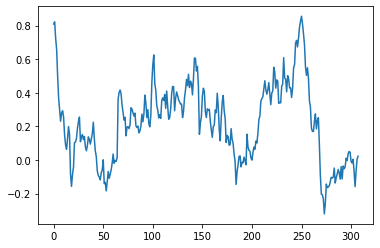

In [141]:
plt.plot(avgs)

In [116]:
i=70
df_now[11] = df[df['Date']==qrtrs[i-2]] 
df_now[0] = df[df['Date']==qrtrs[i-1]] 
df_now[1] = df[df['Date']==qrtrs[i]]
df_now[12] = df[df['Date']==qrtrs[i-11]]
df_now[48] = df[df['Date']==qrtrs[i-59]]
ret=[]
cus_0 = list(df_now[0]['CUSIP'])
cus_12 = list(df_now[12]['CUSIP'])
sh_cus = list(set(cus_0) & set(cus_12))

In [188]:
df_now[1][df_now[1]['CUSIP']==sh_cus[j]]['Returns'].iloc[0]

'0.088144'

In [165]:
df_now[0] = data_CRSP[data_CRSP['Date']==qrtrs[i-1]] 
ret=[]
for j in range(len(df_now[0])):
    if df_now[0].iloc[j]['Returns'] != 'C':
        print(float(df_now[0].iloc[j]['Returns']))
   

-0.074074
0.011494
0.05
0.048544
0.03942
0.050847
0.05
0.048951
0.013514
0.031746
-0.104167
0.115385
0.217391
0.131579
0.315789
-0.039548
0.326531
-0.040816
0.234375
0.070796
0.164835
0.203252
0.045455
0.126984
0.05974
0.105263
0.036697
-0.131579
0.133333
0.088496
0.16
-0.236842
-0.047619
0.305556
-0.04
0.078125
0.168539
0.0625
0.166667
0.425926
0.17284
0.010204
0.049573
0.19403
0.086957
0.0625
0.104651
-0.041667
-0.031847
-0.027027
0.115385
0.075
-0.041667
0.197531
0.05814
-0.02439
0.485714
-0.016931
0.27907
-0.018519
0.157895
0.083333
-0.103448
0.253521
0.201681
-0.044118
0.327869
0.052632
0.1
-0.073684
-0.0336
-0.0625
0.051282
0.17757
-0.0125
0.344538
0.09589
-0.036232
-0.142857
0.5
0.062745
0.046875
0.0
0.372549
-0.03125
-0.05
0.020202
0.52
-0.011236
0.02
-0.012048
0.131579
0.092437
-0.020225
0.084211
0.086957
0.202797
0.125
0.11194
0.2
0.387097
0.245614
0.155963
0.026316
-0.02016
-0.046512
0.084848
-0.066667
0.259259
-0.01005
0.430233
0.096154
0.0
0.025
0.15625
0.028571
-0.043478


0.029703
0.005133
0.053872
0.023166
0.102941
0.116529
0.150794
0.096386
0.079284
0.0
0.035333
0.091774
-0.041009
-0.08871
0.094763
0.004525
0.096386
0.087432
-0.119266
-0.038647
0.313131
0.10902
-0.057348
-0.048494
0.075229
0.040984
0.035294
0.040541
0.081081
-0.04
0.088889
0.041096
0.037313
0.052083
0.094395
0.391304
0.0
0.131148
0.078947
0.078947
-0.053498
0.256757
0.034202
0.057096
0.2
0.0
0.365854
0.053892
0.009091
-0.135135
-0.018987
0.159043
0.030172
0.269663
0.273684
0.090909
0.0
0.086957
0.117647
0.08
0.082353
0.121693
0.04878
0.138365
0.041667
0.123967
0.536585
0.055718
0.093023
1.918367
0.0
0.104
0.09375
0.029153
0.111888
0.291667
0.014706
-0.069756
0.178571
0.000721
0.560976
0.046358
-0.045146
-0.018182
0.028169
-0.031646
0.109929
0.12069
0.295775
0.050847
0.12069
0.037736
0.192982
0.071034
0.044177
0.031579
0.0
0.003765
0.098765
0.244898
0.235294
0.24031
-0.085271
-0.018182
0.049587
0.25
0.047619
0.160305
0.163891
0.266667
0.022807
0.02828
0.07561
0.018182
0.27619
0.012987


-0.045872
0.105556
0.004835
0.024
-0.064394
0.237113
0.113712
0.068764
0.222222
-0.002529
0.096875
0.043011
-0.014286
0.0
0.141104
0.122222
-0.0681
0.046512
0.082278
-0.033535
0.11551
-0.018487
0.08
0.214286
0.359091
0.118644
0.085202
-0.021164
-0.010526
-0.030303
0.0
-0.06
0.038699
0.019221
-0.022624
0.055696
0.227273
0.230769
0.095588
0.062802
0.0
0.251799
0.23125
0.066667
0.070175
0.155779
0.022901
-0.047264
0.096939
0.067273
-0.017857
-0.030211
0.019231
0.02746
0.122176
0.024876
0.058036
-0.072993
-0.069072
0.148301
0.061644
0.014201
-0.101942
-0.007152
0.140625
0.138462
0.157895
0.074074
-0.052632
0.2
0.02381
0.081967
0.128866
0.314685
0.219512
0.050566
0.083333
0.015873
0.072174
-0.138614
0.021277
0.180147
-0.035714
0.111111
-0.05202
0.141026
0.122366
-0.008333
-0.012048
0.157025
0.086957
-0.08
0.186275
0.050955
0.05913
0.306452
0.258065
0.082051
0.088123
-0.011494
0.428571
0.183333
0.067729
-0.064
0.057471
0.106061
0.135057
-0.053913
0.130505
0.026316
0.04698
-0.008909
0.133929


0.09375
0.382353
0.132353
-0.00198
0.167442
0.0
0.059747
0.010989
0.018519
-0.022222
0.126984
-0.0625
-0.076923
0.181818
0.204545
0.009709
-0.046512
0.0
0.129412
0.009524
-0.432624
0.006557
0.114286
0.101695
-0.009709
0.183099
0.177215
0.012195
0.204545
0.055614
0.164474
0.241206
0.021739
0.027523
0.059259
0.3864
0.0
0.176471
0.042105
-0.093333
0.046784
-0.035714
-0.045455
0.0
0.254386
0.344262
0.11194
0.041657
0.032778
0.0
0.0
0.166667
0.065421
0.063291
0.065574
-0.008333
0.238961
0.010909


In [146]:
qrtrs[i-59]

'200712'

In [177]:
df_now[0]

KeyError: 0

In [201]:
df_class['Returns']

KeyError: 'Returns'

In [11]:
def Agnostic_wr(model):
    df_now = {}     #Stores all data entries for the specific month currently iterated over 
    returns={}      #Holds individual monthly returns for all stocks through 1987-2011
    returns_1 = {}  #Overvalued stock returns
    returns_2 = {}  #2nd quintile...
    returns_3 = {}
    returns_4 = {}
    returns_5 = {}

    pr_returns_1 = {}  #Overvalued stock returns
    pr_returns_2 = {}  #2nd quintile...
    pr_returns_3 = {}
    pr_returns_4 = {}
    pr_returns_5 = {}

    yr_returns_1 = {}  #Overvalued stock returns
    yr_returns_2 = {}  #2nd quintile...
    yr_returns_3 = {}
    yr_returns_4 = {}
    yr_returns_5 = {}

    fo_yr_returns_1 = {}  #Overvalued stock returns
    fo_yr_returns_2 = {}  #2nd quintile...
    fo_yr_returns_3 = {}
    fo_yr_returns_4 = {}
    fo_yr_returns_5 = {}

    portfolio = {}  #Undervalued stock returns
    df_class = load_obj('df_WR')
    qrtrs=df_class.Date.unique()      #Find all the unique quarter dates to be used in filtering data

    qrtrs.sort()

    start = time.time()
    m=0

    for i in range(62,len(qrtrs)-1):
        print(i)

                                 #Calculate returns from last month's portfolio
        df_now[0]=df_class[df_class['Date']==qrtrs[i]]
        for k in range(1,12):
            df_now[k] = df_class[df_class['Date']==qrtrs[i-k]] 
            cus_list[k] = list(df_now[k]['CUSIP'])
            if k==1:
                ten_sh_cus = cus_list[1]
            else:
                ten_sh_cus = list(set(ten_sh_cus) & set(cus_list[k]))

        for k in range(12,60):
            df_now[k] = df_class[df_class['Date']==qrtrs[i-k]] 
            cus_list[k] = list(df_now[k]['CUSIP'])
            if k==12:
                four_sh_cus = cus_list[12]
            else:
                four_sh_cus = list(set(four_sh_cus) & set(cus_list[k]))

    ###################################      1       ######################################      
        if m>0:

            ret=[]
            for j in range(len(portfolio[1])):
                if list(df_now[0][df_now[0]['CUSIP']==portfolio[1][j]]['Returns']):
                    if (df_now[0][df_now[0]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_1[i]=ret

            ret=[]
            for j in range(len(portfolio[1])):
                if list(df_now[1][df_now[1]['CUSIP']==portfolio[1][j]]['Returns']):
                    if (df_now[1][df_now[1]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_1[i]=ret

            ret=[]
            for j in range(len(portfolio[1])):
                ret_sum = 0
                if portfolio[1][j] in ten_sh_cus:
                    for k in range(1,12):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            yr_returns_1[i]=ret

            ret=[]
            for j in range(len(portfolio[1])):
                ret_sum = 0
                if portfolio[1][j] in four_sh_cus:
                    for k in range(12,60):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            fo_yr_returns_1[i]=ret

    ####################################       2             ###############################     

            ret=[]
            for j in range(len(portfolio[2])):
                if list(df_now[0][df_now[0]['CUSIP']==portfolio[2][j]]['Returns']):
                    if (df_now[0][df_now[0]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_2[i]=ret

            ret=[]
            for j in range(len(portfolio[2])):
                if list(df_now[1][df_now[1]['CUSIP']==portfolio[2][j]]['Returns']):
                    if (df_now[1][df_now[1]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_2[i]=ret

            ret=[]
            for j in range(len(portfolio[2])):
                ret_sum = 0
                if portfolio[2][j] in ten_sh_cus:
                    for k in range(1,12):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            yr_returns_2[i]=ret

            ret=[]
            for j in range(len(portfolio[2])):
                ret_sum = 0
                if portfolio[2][j] in four_sh_cus:
                    for k in range(12,60):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            fo_yr_returns_2[i]=ret

    ####################################       3             ###############################  

            ret=[]
            for j in range(len(portfolio[3])):
                if list(df_now[0][df_now[0]['CUSIP']==portfolio[3][j]]['Returns']):
                    ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_3[i]=ret

            ret=[]
            for j in range(len(portfolio[3])):
                if list(df_now[1][df_now[1]['CUSIP']==portfolio[3][j]]['Returns']):
                    ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_3[i]=ret

            ret=[]
            for j in range(len(portfolio[3])):
                ret_sum = 0
                if portfolio[3][j] in ten_sh_cus:
                    for k in range(1,12):      
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            yr_returns_3[i]=ret

            ret=[]
            for j in range(len(portfolio[3])):
                ret_sum = 0
                if portfolio[3][j] in four_sh_cus:
                    for k in range(12,60):     
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            fo_yr_returns_3[i]=ret

    ####################################       4             ###############################   

            ret=[]
            for j in range(len(portfolio[4])):
                if list(df_now[0][df_now[0]['CUSIP']==portfolio[4][j]]['Returns']):
                    if (df_now[0][df_now[0]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_4[i]=ret

            ret=[]
            for j in range(len(portfolio[4])):
                if list(df_now[1][df_now[1]['CUSIP']==portfolio[4][j]]['Returns']):
                    if (df_now[1][df_now[1]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_4[i]=ret

            ret=[]
            for j in range(len(portfolio[4])):
                ret_sum = 0
                if portfolio[4][j] in ten_sh_cus:
                    for k in range(1,12):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            yr_returns_4[i]=ret

            ret=[]
            for j in range(len(portfolio[4])):
                ret_sum = 0
                if portfolio[4][j] in four_sh_cus:
                    for k in range(12,60):        
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            fo_yr_returns_4[i]=ret
    ####################################       5             ###############################  

            ret=[]
            for j in range(len(portfolio[5])):
                if list(df_now[0][df_now[0]['CUSIP']==portfolio[5][j]]['Returns']):
                    if (df_now[0][df_now[0]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_5[i]=ret

            ret=[]
            for j in range(len(portfolio[5])):
                if list(df_now[1][df_now[1]['CUSIP']==portfolio[5][j]]['Returns']):
                    if (df_now[1][df_now[1]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_5[i]=ret

            ret=[]
            for j in range(len(portfolio[5])):
                ret_sum = 0
                if portfolio[5][j] in ten_sh_cus:
                    for k in range(1,12):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            yr_returns_5[i]=ret

            ret=[]
            for j in range(len(portfolio[5])):
                ret_sum = 0
                if portfolio[5][j] in four_sh_cus:
                    for k in range(12,60):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum+=float(df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            fo_yr_returns_5[i]=ret


                    #Run Model to sort the stock's into quintiles based off of mispricing

        X = df_now[1].loc[:, features]   #Extract feature variable data
        X = X.fillna(X.mean())
        #X = scalar.fit_transform(X_tempscaled)
        #X = np.nan_to_num(X)
        Y = df_now[1].loc[:,['Price']].values   #Extract target data
        Y = Y.astype('float').ravel()
        #inds = [item for sublist in np.argwhere(np.isnan(Y.values)[:,0]) for item in sublist]  #indices of nan for Y
        #X_train, X_test = train_test_split(df, test_size=0.2)
        #X=X.drop(X.index[inds])
        #Y=Y.drop(Y.index[inds])

        #TPOT testing
        #start_time = time.time()
        model.fit(X, Y)
        #elapsed = time.time() - start_time
        #print(elapsed)
        #winning_pipes = winning_pipes.append(tpot.fitted_pipeline_)
        #print(tpot.score(X, Y))

        #model = MLPRegressor(hidden_layer_sizes=(15, ), activation='relu', solver='adam', alpha=0.001, batch_size='auto', learning_rate='constant', learning_rate_init=0.001, power_t=0.5, max_iter=200, shuffle=True, random_state=None, tol=0.0001, verbose=False, warm_start=False, momentum=0.9, nesterovs_momentum=True, early_stopping=False, validation_fraction=0.1, beta_1=0.9, beta_2=0.999, epsilon=1e-08)

        #model.fit(X, Y)    #Fit the data using model
        pp=model.predict(X)
        perc_dif=(pp-Y.flatten())/abs(Y.flatten())    #Calculate the percent deviation of real value from predicted value
        df_temp1=pd.DataFrame(pp)
        df_temp1.columns=['Predicted Value']
        df_temp2=pd.DataFrame(perc_dif)
        df_temp2.columns=['Percentage Deviation']
        df_model=pd.concat([df_temp1, df_temp2], axis=1) 

        result = pd.concat([df_now[1][['CUSIP','Price']].reset_index(), df_model], axis=1)  #Stores Cusip number of stock with its percent deviation, predicted price and real price in dataframe

        srted=result.sort_values(by=['Percentage Deviation'])    #Sorted verion of result
        q=round(len(srted)/5)
        q2=round(len(srted)/10)

                                            #Update the portfolio

        portfolio[1] = list(srted['CUSIP'][:q])
        portfolio[2] = list(srted['CUSIP'][q:2*q])
        portfolio[3] = list(srted['CUSIP'][2*q:3*q])
        portfolio[4] = list(srted['CUSIP'][3*q:4*q])
        if 5*q>len(srted):
            portfolio[5] = list(srted['CUSIP'][4*q:])
        portfolio[5] = list(srted['CUSIP'][4*q:5*q])

        #portfolio_1[k] = srted['CUSIP'][:q]
        #portfolio_con_3M[m] = list(srted['CUSIP'])

            #The data for this time period has processed to find under-and-overvalued stocks so we must add the to our porfolio
            #as well as look at the returns gained from stocks priorly held.  I will also do a control that tracks an even distribution investment

        m+=1
    dt=qrtrs[i]
    returns[1]=returns_1
    returns[2]=returns_2
    returns[3]=returns_3
    returns[4]=returns_4
    returns[5]=returns_5

    pr_returns = {}
    pr_returns[1]=pr_returns_1
    pr_returns[2]=pr_returns_2
    pr_returns[3]=pr_returns_3
    pr_returns[4]=pr_returns_4
    pr_returns[5]=pr_returns_5

    yr_returns = {}
    yr_returns[1]=yr_returns_1
    yr_returns[2]=yr_returns_2
    yr_returns[3]=yr_returns_3
    yr_returns[4]=yr_returns_4
    yr_returns[5]=yr_returns_5

    fo_yr_returns = {}
    fo_yr_returns[1]=fo_yr_returns_1
    fo_yr_returns[2]=fo_yr_returns_2
    fo_yr_returns[3]=fo_yr_returns_3
    fo_yr_returns[4]=fo_yr_returns_4
    fo_yr_returns[5]=fo_yr_returns_5

    ret = {}
    ret['ret'] = returns
    ret['pr'] = pr_returns
    ret['yr'] = yr_returns
    ret['fo'] = fo_yr_returns

    end = time.time()
    print(end-start)

    return ret

In [12]:
def Agnostic_wr2(model):
    df_now = {}     #Stores all data entries for the specific month currently iterated over 
    returns={}      #Holds individual monthly returns for all stocks through 1987-2011
    returns_1 = {}  #Overvalued stock returns
    returns_2 = {}  #2nd quintile...
    returns_3 = {}
    returns_4 = {}
    returns_5 = {}

    pr_returns_1 = {}  #Overvalued stock returns
    pr_returns_2 = {}  #2nd quintile...
    pr_returns_3 = {}
    pr_returns_4 = {}
    pr_returns_5 = {}

    yr_returns_1 = {}  #Overvalued stock returns
    yr_returns_2 = {}  #2nd quintile...
    yr_returns_3 = {}
    yr_returns_4 = {}
    yr_returns_5 = {}

    fo_yr_returns_1 = {}  #Overvalued stock returns
    fo_yr_returns_2 = {}  #2nd quintile...
    fo_yr_returns_3 = {}
    fo_yr_returns_4 = {}
    fo_yr_returns_5 = {}

    portfolio = {}  #Undervalued stock returns
    df_class = load_obj('df_WR')
    qrtrs=df_class.Date.unique()      #Find all the unique quarter dates to be used in filtering data

    qrtrs.sort()

    start = time.time()
    m=0

    for i in range(62,len(qrtrs)-1):
        print(i)

                                 #Calculate returns from last month's portfolio
        df_now[0]=df_class[df_class['Date']==qrtrs[i]]
        for k in range(1,12):
            df_now[k] = df_class[df_class['Date']==qrtrs[i-k]] 
            cus_list[k] = list(df_now[k]['CUSIP'])
            if k==1:
                ten_sh_cus = cus_list[1]
            else:
                ten_sh_cus = list(set(ten_sh_cus) & set(cus_list[k]))

        for k in range(12,60):
            df_now[k] = df_class[df_class['Date']==qrtrs[i-k]] 
            cus_list[k] = list(df_now[k]['CUSIP'])
            if k==12:
                four_sh_cus = cus_list[12]
            else:
                four_sh_cus = list(set(four_sh_cus) & set(cus_list[k]))

    ###################################      1       ######################################      
        if m>0:

            ret=[]
            for j in range(len(portfolio[1])):
                if list(df_now[0][df_now[0]['CUSIP']==portfolio[1][j]]['Returns']):
                    if (df_now[0][df_now[0]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_1[i]=ret

            ret=[]
            for j in range(len(portfolio[1])):
                if list(df_now[1][df_now[1]['CUSIP']==portfolio[1][j]]['Returns']):
                    if (df_now[1][df_now[1]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_1[i]=ret

            ret=[]
            for j in range(len(portfolio[1])):
                ret_sum = 1
                if portfolio[1][j] in ten_sh_cus:
                    for k in range(1,12):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum=ret_sum*(1+float(df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]))
                ret.append(ret_sum)
            yr_returns_1[i]=ret

            ret=[]
            for j in range(len(portfolio[1])):
                ret_sum = 1
                if portfolio[1][j] in four_sh_cus:
                    for k in range(12,60):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum=ret_sum*(1+float(df_now[k][df_now[k]['CUSIP']==portfolio[1][j]]['Returns'].iloc[0]))
                ret.append(ret_sum)
            fo_yr_returns_1[i]=ret

    ####################################       2             ###############################     

            ret=[]
            for j in range(len(portfolio[2])):
                if list(df_now[0][df_now[0]['CUSIP']==portfolio[2][j]]['Returns']):
                    if (df_now[0][df_now[0]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_2[i]=ret

            ret=[]
            for j in range(len(portfolio[2])):
                if list(df_now[1][df_now[1]['CUSIP']==portfolio[2][j]]['Returns']):
                    if (df_now[1][df_now[1]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_2[i]=ret

            ret=[]
            for j in range(len(portfolio[2])):
                ret_sum = 1
                if portfolio[2][j] in ten_sh_cus:
                    for k in range(1,12):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum=ret_sum*(1+float(df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]))
                ret.append(ret_sum)
            yr_returns_2[i]=ret

            ret=[]
            for j in range(len(portfolio[2])):
                ret_sum = 1
                if portfolio[2][j] in four_sh_cus:
                    for k in range(12,60):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum=ret_sum*(1+float(df_now[k][df_now[k]['CUSIP']==portfolio[2][j]]['Returns'].iloc[0]))
                ret.append(ret_sum)
            fo_yr_returns_2[i]=ret

    ####################################       3             ###############################  

            ret=[]
            for j in range(len(portfolio[3])):
                if list(df_now[0][df_now[0]['CUSIP']==portfolio[3][j]]['Returns']):
                    ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_3[i]=ret

            ret=[]
            for j in range(len(portfolio[3])):
                if list(df_now[1][df_now[1]['CUSIP']==portfolio[3][j]]['Returns']):
                    ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_3[i]=ret

            ret=[]
            for j in range(len(portfolio[3])):
                ret_sum = 1
                if portfolio[3][j] in ten_sh_cus:
                    for k in range(1,12):      
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum1=ret_sum*(1+float(df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0]))
                ret.append(ret_sum)
            yr_returns_3[i]=ret

            ret=[]
            for j in range(len(portfolio[3])):
                ret_sum = 1
                if portfolio[3][j] in four_sh_cus:
                    for k in range(12,60):     
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum=ret_sum*(1+float(df_now[k][df_now[k]['CUSIP']==portfolio[3][j]]['Returns'].iloc[0]))
                ret.append(ret_sum)
            fo_yr_returns_3[i]=ret

    ####################################       4             ###############################   

            ret=[]
            for j in range(len(portfolio[4])):
                if list(df_now[0][df_now[0]['CUSIP']==portfolio[4][j]]['Returns']):
                    if (df_now[0][df_now[0]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_4[i]=ret

            ret=[]
            for j in range(len(portfolio[4])):
                if list(df_now[1][df_now[1]['CUSIP']==portfolio[4][j]]['Returns']):
                    if (df_now[1][df_now[1]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_4[i]=ret

            ret=[]
            for j in range(len(portfolio[4])):
                ret_sum = 1
                if portfolio[4][j] in ten_sh_cus:
                    for k in range(1,12):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum=ret_sum*(1+float(df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]))
                ret.append(ret_sum)
            yr_returns_4[i]=ret

            ret=[]
            for j in range(len(portfolio[4])):
                ret_sum = 1
                if portfolio[4][j] in four_sh_cus:
                    for k in range(12,60):        
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum=ret_sum*(1+float(df_now[k][df_now[k]['CUSIP']==portfolio[4][j]]['Returns'].iloc[0]))
                ret.append(ret_sum)
            fo_yr_returns_4[i]=ret
    ####################################       5             ###############################  

            ret=[]
            for j in range(len(portfolio[5])):
                if list(df_now[0][df_now[0]['CUSIP']==portfolio[5][j]]['Returns']):
                    if (df_now[0][df_now[0]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[0][df_now[0]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            returns_5[i]=ret

            ret=[]
            for j in range(len(portfolio[5])):
                if list(df_now[1][df_now[1]['CUSIP']==portfolio[5][j]]['Returns']):
                    if (df_now[1][df_now[1]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                        ret_sum=float(df_now[1][df_now[1]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0])
                ret.append(ret_sum)
            pr_returns_5[i]=ret

            ret=[]
            for j in range(len(portfolio[5])):
                ret_sum = 1
                if portfolio[5][j] in ten_sh_cus:
                    for k in range(1,12):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum=ret_sum*(1+float(df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]))
                ret.append(ret_sum)
            yr_returns_5[i]=ret

            ret=[]
            for j in range(len(portfolio[5])):
                ret_sum = 1
                if portfolio[5][j] in four_sh_cus:
                    for k in range(12,60):
                        if list(df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns']):
                            if (df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]) != 'C':
                                ret_sum=ret_sum*(1+float(df_now[k][df_now[k]['CUSIP']==portfolio[5][j]]['Returns'].iloc[0]))
                ret.append(ret_sum)
            fo_yr_returns_5[i]=ret


                    #Run Model to sort the stock's into quintiles based off of mispricing

        X = df_now[1].loc[:, features]   #Extract feature variable data
        X = X.fillna(X.mean())
        #X = scalar.fit_transform(X_tempscaled)
        #X = np.nan_to_num(X)
        Y = df_now[1].loc[:,['Price']].values   #Extract target data
        Y = Y.astype('float').ravel()
        #inds = [item for sublist in np.argwhere(np.isnan(Y.values)[:,0]) for item in sublist]  #indices of nan for Y
        #X_train, X_test = train_test_split(df, test_size=0.2)
        #X=X.drop(X.index[inds])
        #Y=Y.drop(Y.index[inds])

        #TPOT testing
        #start_time = time.time()
        model.fit(X, Y)
        #elapsed = time.time() - start_time
        #print(elapsed)
        #winning_pipes = winning_pipes.append(tpot.fitted_pipeline_)
        #print(tpot.score(X, Y))

        #model = MLPRegressor(hidden_layer_sizes=(15, ), activation='relu', solver='adam', alpha=0.001, batch_size='auto', learning_rate='constant', learning_rate_init=0.001, power_t=0.5, max_iter=200, shuffle=True, random_state=None, tol=0.0001, verbose=False, warm_start=False, momentum=0.9, nesterovs_momentum=True, early_stopping=False, validation_fraction=0.1, beta_1=0.9, beta_2=0.999, epsilon=1e-08)

        #model.fit(X, Y)    #Fit the data using model
        pp=model.predict(X)
        perc_dif=(pp-Y.flatten())/abs(Y.flatten())    #Calculate the percent deviation of real value from predicted value
        df_temp1=pd.DataFrame(pp)
        df_temp1.columns=['Predicted Value']
        df_temp2=pd.DataFrame(perc_dif)
        df_temp2.columns=['Percentage Deviation']
        df_model=pd.concat([df_temp1, df_temp2], axis=1) 

        result = pd.concat([df_now[1][['CUSIP','Price']].reset_index(), df_model], axis=1)  #Stores Cusip number of stock with its percent deviation, predicted price and real price in dataframe

        srted=result.sort_values(by=['Percentage Deviation'])    #Sorted verion of result
        q=round(len(srted)/5)
        q2=round(len(srted)/10)

                                            #Update the portfolio

        portfolio[1] = list(srted['CUSIP'][:q])
        portfolio[2] = list(srted['CUSIP'][q:2*q])
        portfolio[3] = list(srted['CUSIP'][2*q:3*q])
        portfolio[4] = list(srted['CUSIP'][3*q:4*q])
        if 5*q>len(srted):
            portfolio[5] = list(srted['CUSIP'][4*q:])
        portfolio[5] = list(srted['CUSIP'][4*q:5*q])

        #portfolio_1[k] = srted['CUSIP'][:q]
        #portfolio_con_3M[m] = list(srted['CUSIP'])

            #The data for this time period has processed to find under-and-overvalued stocks so we must add the to our porfolio
            #as well as look at the returns gained from stocks priorly held.  I will also do a control that tracks an even distribution investment

        m+=1
    dt=qrtrs[i]
    returns[1]=returns_1
    returns[2]=returns_2
    returns[3]=returns_3
    returns[4]=returns_4
    returns[5]=returns_5

    pr_returns = {}
    pr_returns[1]=pr_returns_1
    pr_returns[2]=pr_returns_2
    pr_returns[3]=pr_returns_3
    pr_returns[4]=pr_returns_4
    pr_returns[5]=pr_returns_5

    yr_returns = {}
    yr_returns[1]=yr_returns_1
    yr_returns[2]=yr_returns_2
    yr_returns[3]=yr_returns_3
    yr_returns[4]=yr_returns_4
    yr_returns[5]=yr_returns_5

    fo_yr_returns = {}
    fo_yr_returns[1]=fo_yr_returns_1
    fo_yr_returns[2]=fo_yr_returns_2
    fo_yr_returns[3]=fo_yr_returns_3
    fo_yr_returns[4]=fo_yr_returns_4
    fo_yr_returns[5]=fo_yr_returns_5

    ret = {}
    ret['ret'] = returns
    ret['pr'] = pr_returns
    ret['yr'] = yr_returns
    ret['fo'] = fo_yr_returns

    end = time.time()
    print(end-start)

    return ret

In [357]:
wr_LR2 = Agnostic_wr2(linear_model.LinearRegression())


62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
32

In [359]:
save_obj(wr_LR2, 'wr_LR2')


In [318]:
avgs={}
for i in range(1,6):
    l=[]
    for j in range(63,80):
        l.append(np.mean(returns[i][j]))
    avgs[i]=l
        

In [317]:
x=[]
for n in range(1,6):
    x.append(100*np.mean(avgs[n]))
print(x)
np.mean(x)

[0.05311846473654877, 0.2630430803552613, 0.1547603593418038, -0.20193361020917874, 1.6485938186056175]


0.3835164225660105

In [319]:
x=[]
for n in range(1,6):
    x.append(100*np.mean(avgs[n]))
print(x)
np.mean(x)

[0.0856316783551397, 0.17805248901043821, 0.11729761536801099, 0.07271572833158634, 1.4869834769525798]


0.388136197603551

In [24]:
returns_LR = load_obj('wr_LR')
wr_LR2 = load_obj('wr_LR2')
returns_SVR = load_obj('wr_SVR')
#returns_scSVR = load_obj('nreturns_scSVR')
#returns_auSVR = load_obj('nreturns_auSVR')
#returns_ARD = load_obj('nreturns_ARD')

In [45]:
total_ret_LR, avg_ret_LR = TotalReturns1M(returns_LR['ret'])
pr_total_ret_LR, pr_avg_ret_LR = TotalReturns1M(returns_LR['pr'])
yr_total_ret_LR, yr_avg_ret_LR = yr_TotalReturns1M(returns_LR['yr'])
fo_yr_total_ret_LR, fo_yr_avg_ret_LR = fo_TotalReturns1M(returns_LR['fo'])

total_ret_wLR, avg_ret_wLR = TotalReturns1M(wr_LR2['ret'])
pr_total_ret_wLR, pr_avg_ret_wLR = TotalReturns1M(wr_LR2['pr'])
yr_total_ret_wLR, yr_avg_ret_wLR = yr_TotalReturns1M(wr_LR2['yr'])
fo_yr_total_ret_wLR, fo_yr_avg_ret_wLR = fo_TotalReturns1M(wr_LR2['fo'])

total_ret_SVR, avg_ret_SVR = TotalReturns1M(returns_SVR['ret'])
pr_total_ret_SVR, pr_avg_ret_SVR = TotalReturns1M(returns_SVR['pr'])
yr_total_ret_SVR, yr_avg_ret_SVR = yr_TotalReturns1M(returns_SVR['yr'])
fo_yr_total_ret_SVR, fo_yr_avg_ret_SVR = fo_TotalReturns1M(returns_SVR['fo'])

In [26]:
#Quantify the performance of the models in each quintile and control
models = [avg_ret_LR, pr_avg_ret_LR, yr_avg_ret_LR, fo_yr_avg_ret_LR]

import inspect, re

def namestr(obj, namespace):
    return [name for name in namespace if namespace[name] is obj]
a = {} 
m=0
for j in models:
    a[m]=[]
    print(namestr(j,globals()),':')
    for i in range(0,6):
        print(100*(np.mean(j[i])-1))
        a[m].append(100*(np.mean(j[i])-1))
    m+=1

['avg_ret_LR', 'j'] :
1.3705512561005717
0.9931032819064267
1.0192482819312287
1.082797435843652
1.226136406529199
2.531470874292352
['pr_avg_ret_LR', 'j'] :
1.4440379723788865
0.97266270475449
1.0071452358668465
1.1014068725576642
1.2306925121471801
2.9082825365683407
['yr_avg_ret_LR', 'j'] :
12.034184420702898
23.912343895232667
17.830964422401017
13.562686097572453
7.497606200527618
-2.632678512219211
['fo_yr_avg_ret_LR', 'j'] :
36.260174494000076
58.0740304654765
49.49024108826494
37.64093697949138
24.57308791079884
11.522576025968645


In [46]:
#Quantify the performance of the models in each quintile and control
models = [avg_ret_wLR, pr_avg_ret_wLR, yr_avg_ret_wLR, fo_yr_avg_ret_wLR]

import inspect, re

def namestr(obj, namespace):
    return [name for name in namespace if namespace[name] is obj]
a = {} 
m=0
for j in models:
    a[m]=[]
    print(namestr(j,globals()),':')
    for i in range(0,6):
        print(100*(np.mean(j[i])-1))
        a[m].append(100*(np.mean(j[i])-1))
    m+=1

['avg_ret_wLR', 'j'] :
1.3820992688665656
1.0056707008214039
1.0255936438038127
1.088865530031935
1.2434115493948905
2.5469549202807196
['pr_avg_ret_wLR', 'j'] :
1.4440379723788865
0.97266270475449
1.0071452358668465
1.1014068725576642
1.2306925121471801
2.9082825365683407
['yr_avg_ret_wLR', 'j'] :
9.549647073095912
27.973746198534077
18.64648800678943
0.0
5.654944140383078
-4.526942980226966
['fo_yr_avg_ret_wLR', 'j'] :
43.40665947067461
81.03068138330418
62.13129610395758
42.085686531367905
22.878823201581746
8.906810133161702


In [32]:
#Quantify the performance of the models in each quintile and control
models = [avg_ret_wLR2, pr_avg_ret_wLR2, yr_avg_ret_wLR2, fo_yr_avg_ret_wLR2]

import inspect, re

def namestr(obj, namespace):
    return [name for name in namespace if namespace[name] is obj]
a = {} 
m=0
for j in models:
    a[m]=[]
    print(namestr(j,globals()),':')
    for i in range(0,6):
        print(100*(np.mean(j[i])-1))
        a[m].append(100*(np.mean(j[i])-1))
    m+=1

NameError: name 'avg_ret_wLR2' is not defined

In [389]:
for k in range(4):
    print(np.corrcoef([1,2,3,4,5], a[k][1:])[0, 1])

0.7923802754255975
0.785140362310744
-0.9872293756938928
-0.9969808805119661


In [28]:
#Quantify the performance of the models in each quintile and control
models = [avg_ret_SVR, pr_avg_ret_SVR, yr_avg_ret_SVR, fo_yr_avg_ret_SVR]

import inspect, re

def namestr(obj, namespace):
    return [name for name in namespace if namespace[name] is obj]
    
for j in models:
    print(namestr(j,globals()),':')
    for i in range(0,6):
        print(np.mean(j[i]))

['avg_ret_SVR', 'j'] :
1.013936969201025
1.009439023625091
1.0102961366191778
1.0107341076055023
1.011826840591879
1.0273887375634752
['pr_avg_ret_SVR', 'j'] :
1.014565371168182
1.008996640021466
1.0103301455537013
1.0111333419713453
1.0117407383083263
1.0306259899860704
['yr_avg_ret_SVR', 'j'] :
1.1203281056490326
1.2402354079359625
1.1770597840980979
1.1335274436671505
1.0773956467784767
0.9734222457654762
['fo_yr_avg_ret_SVR', 'j'] :
1.3626065243855927
1.6761410600511766
1.5018950856035498
1.3468450062063635
1.2120480238454887
1.0761034462213859


Text(0, 0.5, 'Ratio to Starting Value')

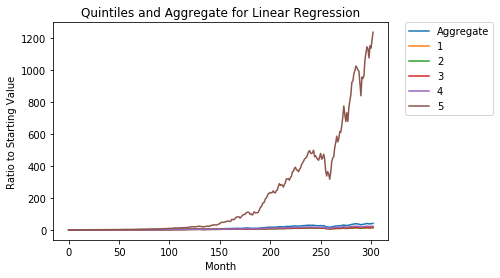

In [29]:
                                    #Plot of individual quintiles
plt.plot(list(total_ret_LR[0]), label = 'Aggregate')
plt.plot(list(total_ret_LR[1]), label = '1')
plt.plot(list(total_ret_LR[2]), label = '2')
plt.plot(list(total_ret_LR[3]), label = '3')
plt.plot(list(total_ret_LR[4]), label = '4')
plt.plot(list(total_ret_LR[5]), label = '5')

#plt.plot(list(total_ret_LR_PCA[5][:100]), label = 'PCA')
#plt.plot(list(total_ret_ARD[5][:100]), label = 'ARD 5')
#plt.plot(list(total_ret_con[30:]), label = 'Control')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Quintiles and Aggregate for Linear Regression")
plt.xlabel('Month')
plt.ylabel('Ratio to Starting Value')

Text(0, 0.5, 'Ratio to Starting Value')

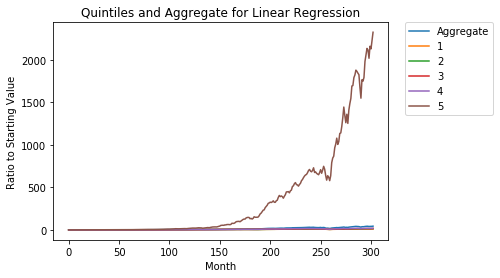

In [30]:
                                    #Plot of individual quintiles
plt.plot(list(total_ret_SVR[0]), label = 'Aggregate')
plt.plot(list(total_ret_SVR[1]), label = '1')
plt.plot(list(total_ret_SVR[2]), label = '2')
plt.plot(list(total_ret_SVR[3]), label = '3')
plt.plot(list(total_ret_SVR[4]), label = '4')
plt.plot(list(total_ret_SVR[5]), label = '5')

#plt.plot(list(total_ret_LR_PCA[5][:100]), label = 'PCA')
#plt.plot(list(total_ret_ARD[5][:100]), label = 'ARD 5')
#plt.plot(list(total_ret_con[30:]), label = 'Control')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Quintiles and Aggregate for Linear Regression")
plt.xlabel('Month')
plt.ylabel('Ratio to Starting Value')

Text(0, 0.5, 'Ratio to Starting Value')

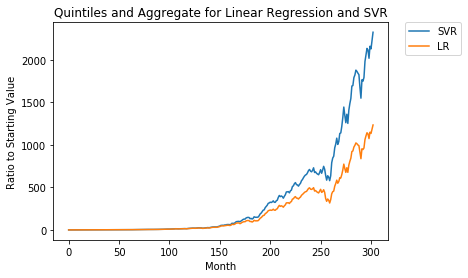

In [31]:
                                    #Plot of individual quintiles
plt.plot(list(total_ret_SVR[5]), label = 'SVR')
plt.plot(list(total_ret_LR[5]), label = 'LR')

#plt.plot(list(total_ret_LR_PCA[5][:100]), label = 'PCA')
#plt.plot(list(total_ret_ARD[5][:100]), label = 'ARD 5')
#plt.plot(list(total_ret_con[30:]), label = 'Control')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Quintiles and Aggregate for Linear Regression and SVR")
plt.xlabel('Month')
plt.ylabel('Ratio to Starting Value')

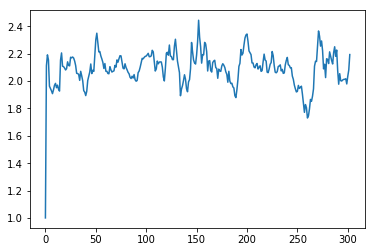

In [37]:
plt.plot(yr_avg_ret_wLR[0])

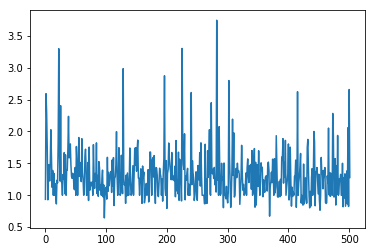

In [41]:
plt.plot(wr_LR2['yr'][1][63])